# An Investigation Into Wellington Earthquakes- EDA notebook

## Data source:

All New Zealand events with magnitude >3.0, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=BBOX(origin_geom,166,-50,179,-34)+AND+origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+magnitude>3

All events within 100km of Wgtn centre, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),100000,meters)

All events within 15km of Wgtn centre, magnitude <3.01, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),15000,meters)+AND+magnitude<3.01

All events within 30km of Wgtn centre, magnitude >3, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),30000,meters)+AND+magnitude>3

All events within 100km of Wgtn centre, magnitude >4, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),100000,meters)+AND+magnitude>4

All events within 300km of Wgtn centre, magnitude >5, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),300000,meters)+AND+magnitude>5

All events within 600km of Wgtn centre, magnitude >6, 1982-1922:  
http://wfs.geonet.org.nz/geonet/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=geonet:quake_search_v1&outputFormat=csv&cql_filter=origintime>='1982-01-01'+AND+origintime<'2022-01-01'+AND+DWITHIN(origin_geom,Point+(174.77557+-41.28664),600000,meters)+AND+magnitude>6

GeoJson New Zealand Source:  
https://simplemaps.com/gis/country/nz#all

Description of Catalogue Outputs

* Field	Description
* publicid	The Public Id, a unique earthquake reference code.
* eventtype	The type of seismic event, eg. earthquake, quarry blast, outside of network interest, etc.
* origintime	The UTC time of the event's occurrence (in ISO 8601 format).
* modificationtime	The UTC time of the event's last update to its information (in ISO 8601 format).
* latitude	The latitude of the event (decimal degrees, WGS84 datum).
* longitude	The longitude of the event (decimal degrees, WGS84 datum).
* depth	The focal depth of the event (km).
* magnitude	The magnitude of the event.
* evaluationmethod	The computer technique used to locate the earthquake.
* evaluationstatus	The status of the location: preliminary, reviewed, etc.
* evaluationmode	The mode of location: manual or automatic.
* earthmodel	The earth model used by the evaluationmethod.
* depthtype	The type of depth determination.
* originerror	The standard error of travel time residuals (seconds).
* usedphasecount	The number of defining phases used computing the location.
* usedstationcount	The number of stations from which phases were used in computing the location.
* minimumdistance	The epicentral distance to the closest station (degrees).
* azimuthalgap	The largest azimuthal gap in station distribution (degrees).
* magnitudetype	The type of magnitude determined.
* magnitudeuncertainty	The standard error of magnitude.
* magnitudestationcount	The number of stations used to determine the magnitude.

In [1]:
#pip install folium

## Loading Data

In [2]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import json
import folium
%matplotlib inline
warnings.filterwarnings('ignore')

### All events within 100km of Wellington centre, 1982-2022

In [3]:
# Read Wellington quake data within 100km:
Wdata = pd.read_csv("earthquakes.csv", header=0)

In [4]:
Wdata.head()

,publicid,eventtype,origintime,modificationtime,longitude,latitude,magnitude,depth,magnitudetype,depthtype,...,evaluationstatus,evaluationmode,earthmodel,usedphasecount,usedstationcount,magnitudestationcount,minimumdistance,azimuthalgap,originerror,magnitudeuncertainty
0,2021p986189,earthquake,2021-12-31T21:21:29.978Z,2021-12-31T21:30:37.684Z,174.634018,-41.372353,3.179019,14.763728,MLv,NaN,...,confirmed,manual,iasp91,46,39,48,0.119452,105.107613,0.367375,0.139927
1,2021p984795,earthquake,2021-12-31T08:59:08.870Z,2021-12-31T09:02:58.385Z,174.422043,-41.561958,1.386793,12.000000,M,operator assigned,...,confirmed,manual,iasp91,18,13,3,0.368004,126.417488,0.630762,0.000000
2,2021p983838,earthquake,2021-12-31T00:29:10.738Z,2021-12-31T00:37:58.683Z,174.370102,-41.563446,1.375757,15.021874,MLv,NaN,...,confirmed,manual,iasp91,18,15,3,0.201347,121.437996,0.369259,0.278051
3,2021p983616,earthquake,2021-12-30T22:31:05.248Z,2021-12-30T22:37:02.889Z,174.927597,-40.569809,1.699024,34.084309,M,NaN,...,preliminary,manual,iasp91,8,5,1,0.291088,285.830521,0.851705,0.000000
4,2021p983445,earthquake,2021-12-30T20:59:55.403Z,2021-12-30T21:58:26.067Z,173.961090,-40.646523,2.255883,68.667740,MLv,NaN,...,confirmed,manual,iasp91,28,24,14,0.157907,96.779907,0.445373,0.253495


In [5]:
Wdata.shape

(98365, 21)

In [6]:
Wdata.isna().sum()

publicid                     0
eventtype                22880
origintime                   0
modificationtime             0
longitude                    0
latitude                     0
magnitude                    0
depth                        0
magnitudetype                0
depthtype                90834
evaluationmethod             6
evaluationstatus         22781
evaluationmode               5
earthmodel                   6
usedphasecount               0
usedstationcount             0
magnitudestationcount        0
minimumdistance              0
azimuthalgap                 0
originerror                  0
magnitudeuncertainty         0
dtype: int64

In [7]:
(Wdata['eventtype'] != 'earthquake').sum()

23120

In [8]:
Wdata.eventtype.unique()

array(['earthquake', nan, 'not locatable', 'quarry blast',
       'outside of network interest'], dtype=object)

In [9]:
pd.isna(Wdata.eventtype).sum()

22880

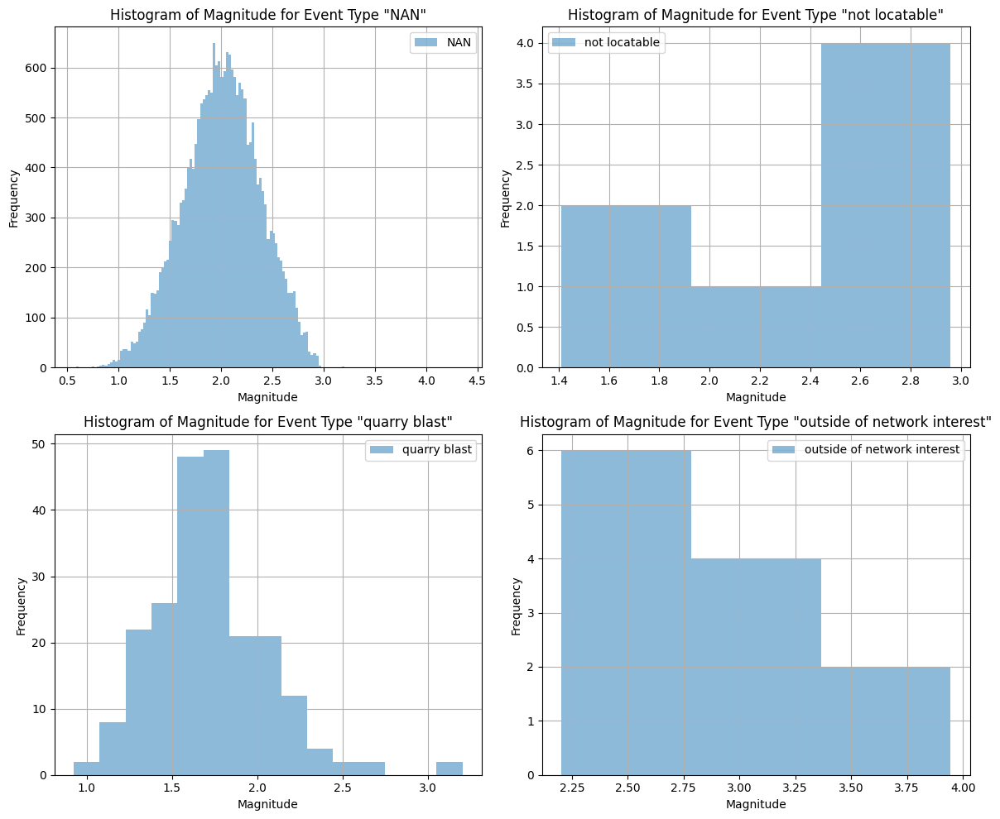

In [10]:
# Investigate magnitude distributions of non-earthquake events:
# Fill NaN values in 'eventtype' column with 'NAN'
Wdata['eventtype'] = Wdata['eventtype'].fillna('NAN')

# Define the four non-earthquake event types
event_types = ['NAN', 'not locatable', 'quarry blast', 'outside of network interest']

# Create subplots with a 2x2 grid layout
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 10))

# Iterate over each event type and plot its histogram
for i, eventtype in enumerate(event_types):
    ax = axes[i // 2, i % 2]  # Calculate subplot position
    group = Wdata[Wdata['eventtype'] == eventtype]
    magnitudes = group['magnitude'][group['magnitude'] >= 0]  # Filter out negative values
    ax.hist(magnitudes, bins=round(len(group['magnitude'])**0.5), alpha=0.5, label=eventtype)
    ax.set_xlabel('Magnitude')
    ax.set_ylabel('Frequency')
    ax.set_title(f'Histogram of Magnitude for Event Type "{eventtype}"')
    ax.legend()
    ax.grid(True)

# Adjust layout
plt.tight_layout()
plt.show()

In [11]:
#Function to find missing values in form of negative values:
def sum_negative_values(df):
    results = {}
    
    for col in df.columns:
        if pd.api.types.is_numeric_dtype(df[col]):
            negative_sum = df[col][df[col] < 0].sum()
            results[col] = negative_sum if not pd.isna(negative_sum) else 0
        else:
            results[col] = 0
    
    return results


In [12]:
sum_negative_values(Wdata)

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'modificationtime': 0,
 'longitude': 0.0,
 'latitude': -4057644.81629871,
 'magnitude': -1629.0,
 'depth': 0.0,
 'magnitudetype': 0,
 'depthtype': 0,
 'evaluationmethod': 0,
 'evaluationstatus': 0,
 'evaluationmode': 0,
 'earthmodel': 0,
 'usedphasecount': 0,
 'usedstationcount': 0,
 'magnitudestationcount': 0,
 'minimumdistance': 0.0,
 'azimuthalgap': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

As there are columns not relevant to the project, re-load the data using only the relevant columns to save memory:

In [13]:
cols = ['publicid','eventtype','origintime','longitude','latitude','magnitude', 'depth','originerror','magnitudeuncertainty']
Wdata = pd.read_csv("earthquakes.csv", usecols=cols, header=0)
Wdata.shape

(98365, 9)

### All events New Zealand wide, greater than magnitude 3.0, 1982-2022

In [14]:
NZdata = pd.read_csv("earthquakesNZ.csv", usecols=cols, header=0)

In [15]:
NZdata.shape

(100770, 9)

In [16]:
NZdata.isna().sum()

publicid                  0
eventtype               107
origintime                0
longitude                 0
latitude                  0
magnitude                 0
depth                     0
originerror               0
magnitudeuncertainty      0
dtype: int64

In [17]:
sum_negative_values(NZdata)

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -4056407.08250128,
 'magnitude': 0.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

### Events tiered by magnitude with range reflective of ability to impact Wellington, 1982-2022

Whilst the ability to feel an earthquake can depend on numerous factors including depth, regional geoology and the built environment, a general approximation can be made based on empirical observations to the relationship between magnitude and distance from the epicenter.  
* Magnitude 2.0-3.0   -Felt only near from the epicenter
* Magnitude 3.0-4.0   -Felt up to 10-25km from the epicenter
* Magnitude 4.0-5.0   -Felt up to 50-100km from the epicenter
* Magnitude 5.0-6.0   -Felt up to 300km from the epicenter
* Magnitude 6.0-7.0   -Felt up to 600km from the epicenter

For this project, the range of interest will be within a 15km range of the centre of Wellington (-41.28664,17477557), so magnitudes below 3 will be considered within 15km, magnitudes 3-4 within 30km, 4-5 within 100km, 5-6 within 300km and 6+ within 600km.

In [18]:
threeminus = pd.read_csv("earthquakes2.csv", usecols=cols, header=0)
threeplus = pd.read_csv("earthquakes3.csv", usecols=cols, header=0)
fourplus = pd.read_csv("earthquakes4.csv", usecols=cols, header=0)
fiveplus = pd.read_csv("earthquakes5.csv", usecols=cols, header=0)
sixplus= pd.read_csv("earthquakes6.csv", usecols=cols, header=0)

In [19]:
display(threeminus.shape)
display(threeminus.isna().sum().sum())
sum_negative_values(threeminus)

(2606, 9)

386

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -107574.89013362,
 'magnitude': -27.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

In [20]:
display(threeplus.shape)
display(threeplus.isna().sum().sum())
sum_negative_values(threeplus)

(586, 9)

2

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -24162.8139371,
 'magnitude': 0.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

In [21]:
display(fourplus.shape)
display(fourplus.isna().sum().sum())
sum_negative_values(fourplus)

(827, 9)

1

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -34236.47614659001,
 'magnitude': 0.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

In [22]:
display(fiveplus.shape)
display(fiveplus.isna().sum().sum())
sum_negative_values(fiveplus)

(300, 9)

0

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -12267.02783761,
 'magnitude': 0.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

In [23]:
display(sixplus.shape)
display(sixplus.isna().sum().sum())
sum_negative_values(sixplus)

(34, 9)

0

{'publicid': 0,
 'eventtype': 0,
 'origintime': 0,
 'longitude': 0.0,
 'latitude': -1364.4978009299998,
 'magnitude': 0.0,
 'depth': 0.0,
 'originerror': 0.0,
 'magnitudeuncertainty': 0.0}

#### Combined Dataframe

In [24]:
Wellington = pd.concat([threeminus,threeplus,fourplus,fiveplus,sixplus])
Wellington['origintime'] = pd.to_datetime(Wellington['origintime'],utc=True)
Wellington = Wellington.sort_values(by='origintime')
Wellington = Wellington.reset_index(drop=True)
Wellington.shape

(4353, 9)

In [25]:
mean_mag=np.mean(Wellington[Wellington['magnitude']>0]['magnitude'])
mean_mag

2.8904407357609196

In [26]:
# Replace values in 'magnitude' that are less than 0 with mean_mag
Wellington.loc[Wellington['magnitude'] < 0, 'magnitude'] = mean_mag

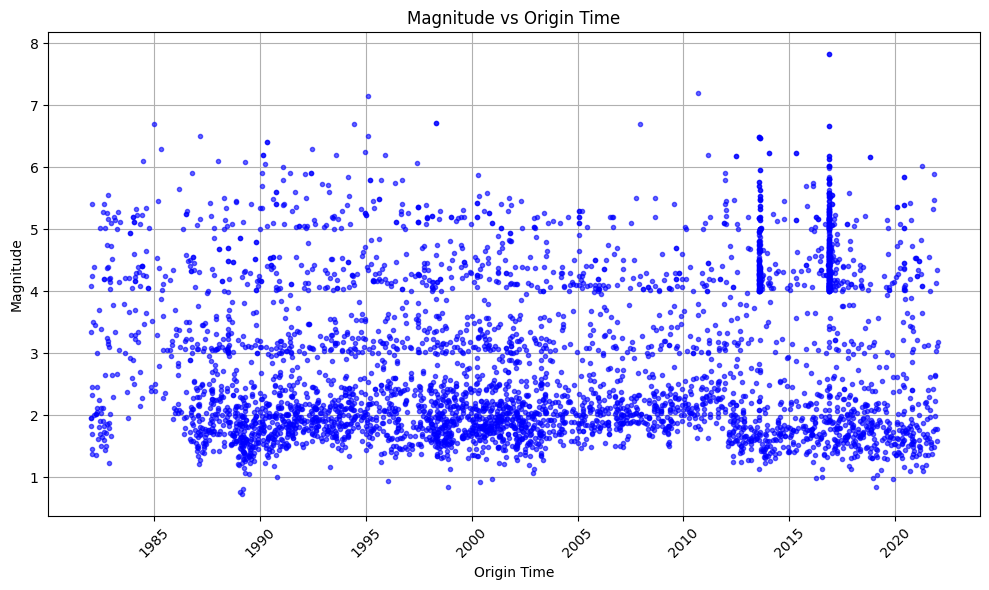

In [124]:
plt.figure(figsize=(10, 6))
plt.plot(Wellington['origintime'], Wellington['magnitude'], marker='.', linestyle='none', color='b',alpha=0.6)
plt.title('Magnitude vs Origin Time')
plt.xlabel('Origin Time')
plt.ylabel('Magnitude')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Adjust layout to fit labels
plt.show()

## Plotting Events with New Zealand overlay

### With MatPlotLib and GeoJson

In [28]:
# Load GeoJSON file for New Zealand
with open('nz.json', 'r') as f:
    nz_geojson = json.load(f)

# Find the feature for New Zealand
nz_feature = None
for feature in nz_geojson['features']:
    if feature['properties']['name'] == 'New Zealand':
        nz_feature = feature
        break

# Check if New Zealand feature was found
if nz_feature is None:
    print("New Zealand feature not found in GeoJSON.")
else:
    # Extract New Zealand's geometry
    nz_geometry = nz_feature['geometry']


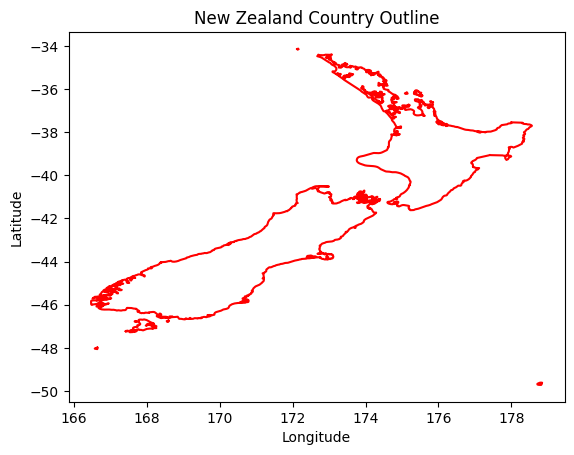

In [29]:
# Plot New Zealand's country outline
for polygon in nz_geometry['coordinates']:
    for coords in polygon:
        x, y = zip(*coords)
        plt.plot(x, y, color='red')  # Adjust color and style as needed
   
 # Add labels, title, etc.
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('New Zealand Country Outline')

plt.show()

In [30]:
def plot_events(lon_min,lon_max,lat_min,lat_max,data, threshold,realm):
    plt.figure(figsize=(12, 8))
    for polygon in nz_geometry['coordinates']:
            for coords in polygon:
                x, y = zip(*coords)
                # Filter points within the bounding box
                x_filtered, y_filtered = [], []
                for xi, yi in zip(x, y):
                    if lon_min <= xi <= lon_max and lat_min <= yi <= lat_max:
                        x_filtered.append(xi)
                        y_filtered.append(yi)
                plt.plot(x_filtered, y_filtered, color='black', linewidth=1)
    sample_data = data[data['magnitude'] > threshold]
    plt.scatter(sample_data['longitude'], sample_data['latitude'], s=4, color='blue', alpha=0.3)
    plt.scatter(174.77557, -41.28664, s=40, color='red', alpha=1)
    # Add labels, title, etc.
    plt.title(f"New Zealand Country Outline with Events greater than {threshold}, within {realm}")
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')

    plt.show()


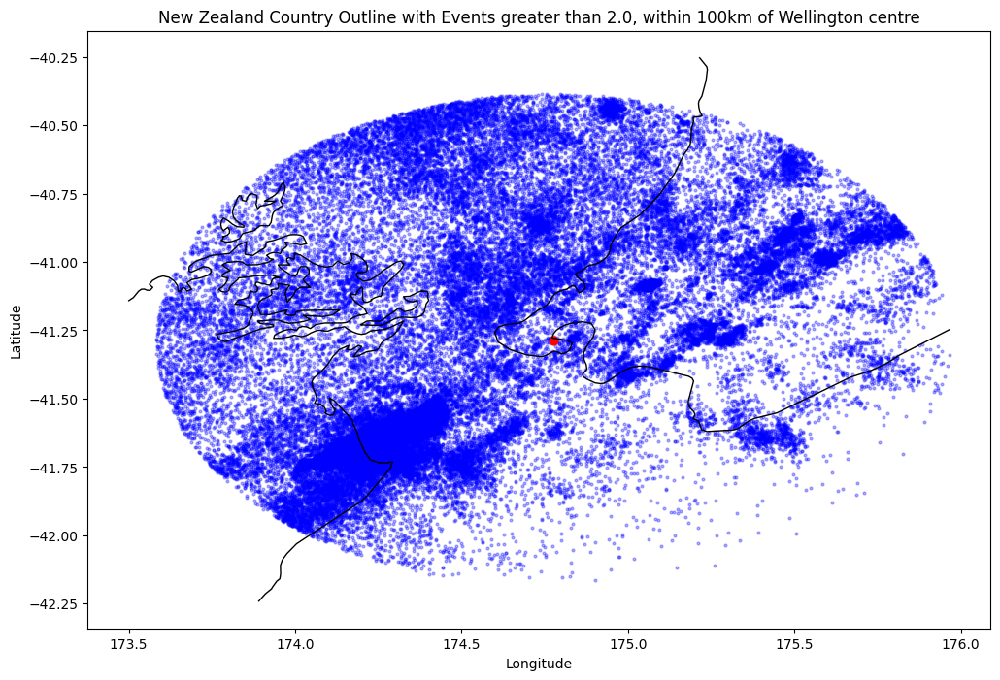

In [50]:
plot_events(173.5,176,-42.25,-40.25,Wdata,2.0,'100km of Wellington centre')

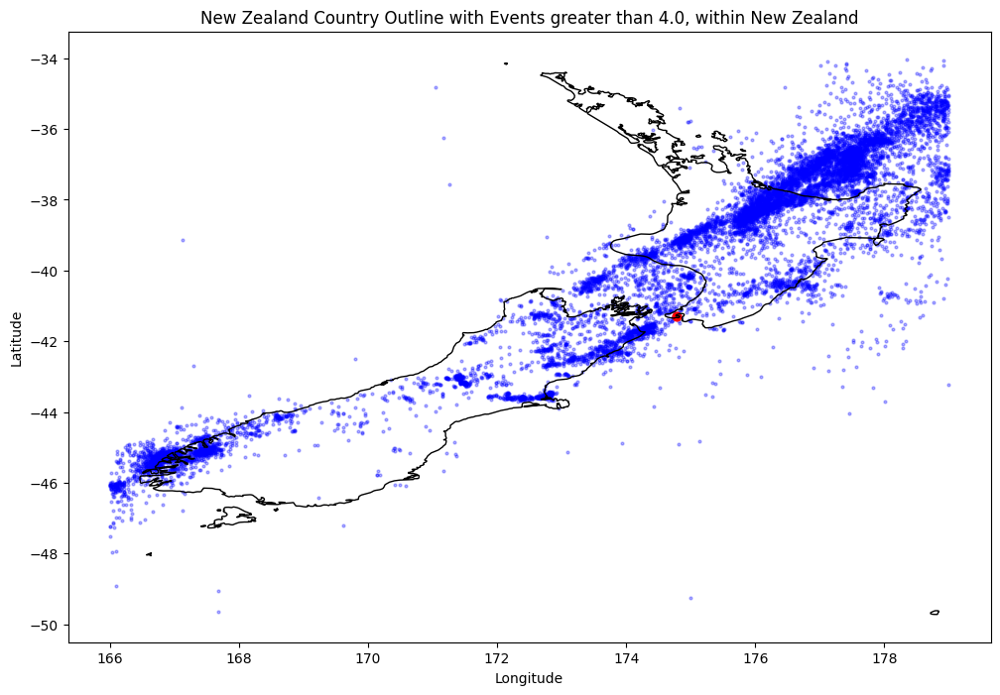

In [52]:
plot_events(164,180,-50,-32,NZdata[NZdata['eventtype'] == 'earthquake'],4.0,'New Zealand')

### Event Clustering

In [33]:
from sklearn.cluster import DBSCAN
import seaborn as sns
from matplotlib.lines import Line2D

In [34]:
def clusterer(df,conds_list,mcs,eps):
    combined_condition = None
    for condition in conds_list:
        if combined_condition is None:
            combined_condition = condition
        else:
            combined_condition &= condition
    subset_df = df[combined_condition]
    db = DBSCAN(eps=eps, min_samples=mcs, n_jobs=-1)
    clusters = db.fit_predict(subset_df[['longitude', 'latitude']])
    return clusters, subset_df
    

In [35]:
def cluster_plot(df,conds_list,mcs,eps):
    # Call clusterer function to get clusters and HDBSCAN object
    clusters, subset_df = clusterer(df, conds_list, mcs,eps)
    
    # Number of clusters excluding noise (label=-1)
    num_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
    
    # Generate cluster colors using Seaborn's color palette
    cluster_colors = sns.color_palette('Set2', num_clusters)
    
    # Plotting
    plt.figure(figsize=(10, 8))
    for polygon in nz_geometry['coordinates']:
            for coords in polygon:
                x, y = zip(*coords)
                plt.plot(x, y, color='black', linewidth=1)
    # Iterate over clusters and plot points
    for cluster_label, color in zip(set(clusters), cluster_colors):
        if cluster_label != -1:
            # Plot cluster points with cluster-specific color
            plt.scatter(subset_df['longitude'][clusters == cluster_label], subset_df['latitude'][clusters == cluster_label],
                        color=color, s=2, label=f'Cluster {cluster_label}')
    # Plot noise points as red '+'
    plt.scatter(subset_df['longitude'][clusters == -1], subset_df['latitude'][clusters == -1],
                color='red', marker='+', s=4, label='Noise')
        
    
    # Plot formatting
    plt.title('DBSCAN Clustering of Seismic Events')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.grid(True)
    plt.show()
    return clusters,subset_df

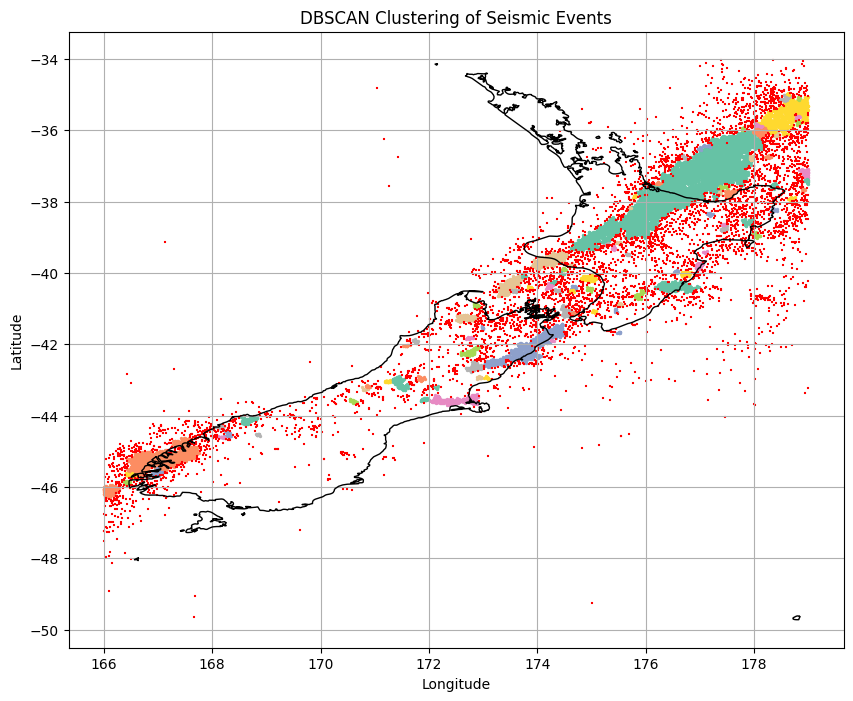

CPU times: user 1.94 s, sys: 83 ms, total: 2.02 s
Wall time: 1.51 s


In [36]:
%%time
cl1, ss1 = cluster_plot(NZdata,[(NZdata['eventtype']=='earthquake'), (NZdata['magnitude']>3.8)],8,0.05)

In [37]:
# Define the grid search function
def perform_grid_search(df, magnitudes, mcs_values, eps_values):
    results = []
    
    for magnitude in magnitudes:
        for mcs in mcs_values:
            for eps in eps_values:
                # Apply magnitude threshold
                conditions = [(df['eventtype'] == 'earthquake'), (df['magnitude'] > magnitude)]
                clusters, subset_df = clusterer(df, conditions, mcs, eps)
                
                # Calculate metrics
                num_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
                num_noise_points = np.sum(clusters == -1)
                total_points = len(clusters)
                noise_percentage = (num_noise_points / total_points) * 100
                
                results.append({
                    'Magnitude Threshold': magnitude,
                    'Min Samples': mcs,
                    'Eps': eps,
                    'Number of Clusters': num_clusters,
                    'Noise Percentage': noise_percentage
                })
    
    return pd.DataFrame(results)

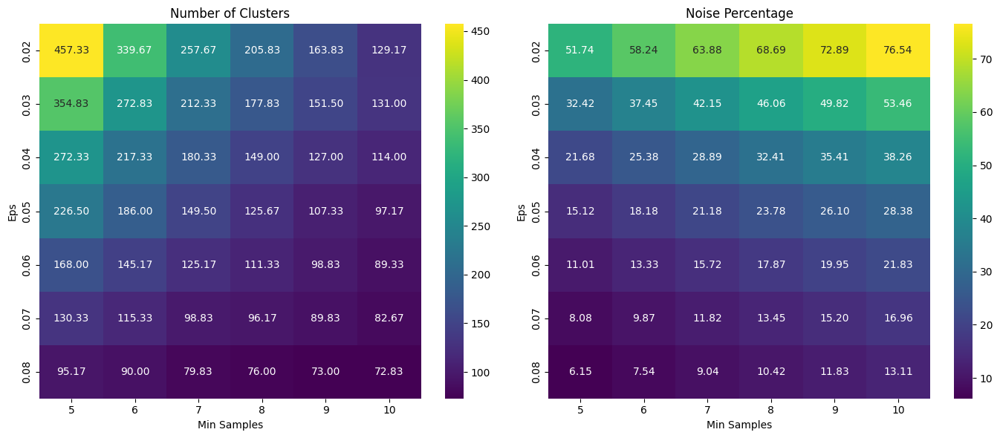

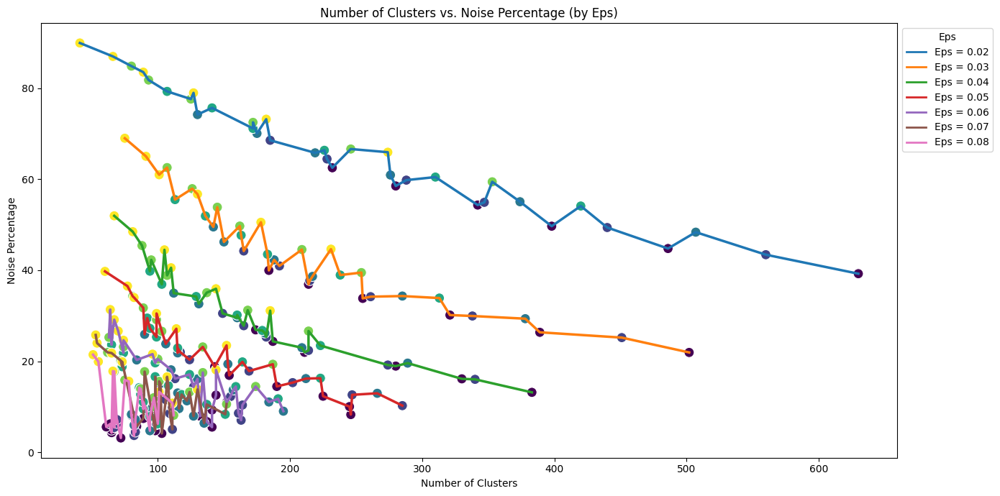

In [38]:
# Define parameters for grid search
magnitudes = [3.5, 3.6,3.7, 3.8, 3.9, 4.0]
mcs_values = [5, 6, 7, 8, 9, 10]
eps_values = [0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08]

# Perform grid search
results_df = perform_grid_search(NZdata, magnitudes, mcs_values, eps_values)

# Visualize results
plt.figure(figsize=(14, 6))

# Heatmap for Number of Clusters
plt.subplot(1, 2, 1)
heatmap_data = results_df.pivot_table(index='Eps', columns='Min Samples', values='Number of Clusters', aggfunc='mean')
sns.heatmap(heatmap_data, annot=True, fmt='.2f', cmap='viridis')
plt.title('Number of Clusters')
plt.xlabel('Min Samples')
plt.ylabel('Eps')

# Heatmap for Noise Percentage
plt.subplot(1, 2, 2)
heatmap_data_noise = results_df.pivot_table(index='Eps', columns='Min Samples', values='Noise Percentage', aggfunc='mean')
sns.heatmap(heatmap_data_noise, annot=True, fmt='.2f', cmap='viridis')
plt.title('Noise Percentage')
plt.xlabel('Min Samples')
plt.ylabel('Eps')

plt.tight_layout()
plt.show()

# Visualization setup
plt.figure(figsize=(14, 7))

# Scatter plot for Number of Clusters vs. Noise Percentage, grouped by eps
sns.scatterplot(data=results_df, x='Number of Clusters', y='Noise Percentage', hue='Magnitude Threshold', palette='viridis', s=100, legend='full')
sns.lineplot(data=results_df, x='Number of Clusters', y='Noise Percentage', hue='Eps', palette='tab10', linewidth=2.5, estimator=None, legend=None)
plt.title('Number of Clusters vs. Noise Percentage (by Eps)')
plt.xlabel('Number of Clusters')
plt.ylabel('Noise Percentage')

# Create custom legend for lines
unique_eps = results_df['Eps'].unique()
line_labels = [Line2D([0], [0], color=sns.color_palette('tab10')[i], lw=2) for i in range(len(unique_eps))]
plt.legend(line_labels, [f'Eps = {eps}' for eps in unique_eps], title='Eps', loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()
plt.show()

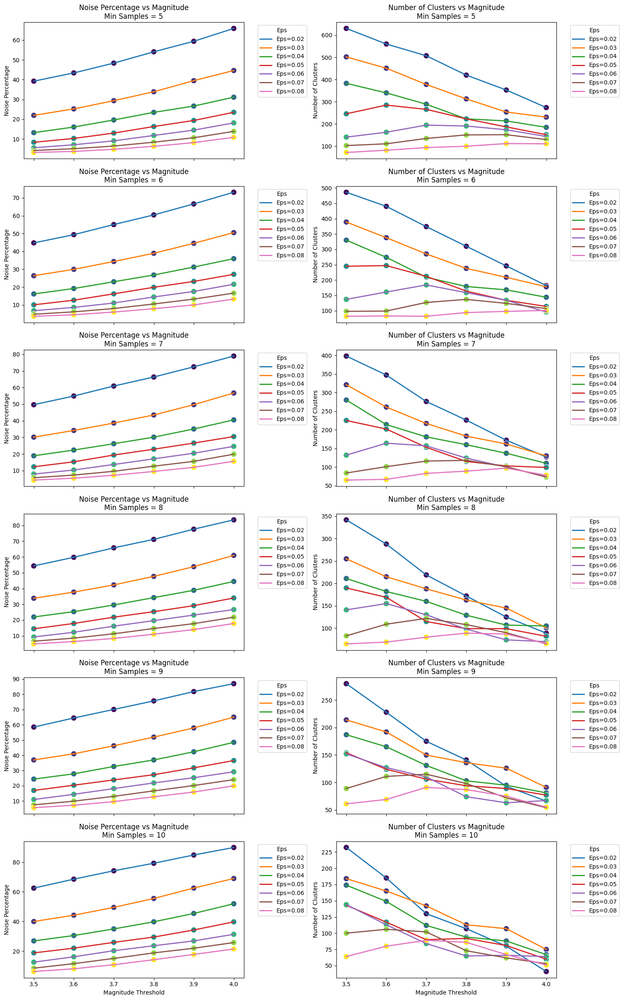

In [39]:
# Set up the figure and axis
unique_min_samples = sorted(results_df['Min Samples'].unique())
n_samples = len(unique_min_samples)
fig, axes = plt.subplots(nrows=n_samples, ncols=2, figsize=(15, 4 * n_samples), sharex='col')

# Iterate over each unique Min Samples value
for idx, min_samples in enumerate(unique_min_samples):
    subset_df = results_df[results_df['Min Samples'] == min_samples]
    
    # Plot Noise Percentage vs. Magnitude with lines
    sns.scatterplot(data=subset_df, x='Magnitude Threshold', y='Noise Percentage', hue='Eps', palette='viridis', ax=axes[idx, 0], s=100, legend=False)
    for eps_val in subset_df['Eps'].unique():
        eps_data = subset_df[subset_df['Eps'] == eps_val]
        sns.lineplot(data=eps_data, x='Magnitude Threshold', y='Noise Percentage', label=f'Eps={eps_val}', ax=axes[idx, 0], palette='viridis', linewidth=2)
    axes[idx, 0].set_title(f'Noise Percentage vs Magnitude\nMin Samples = {min_samples}')
    axes[idx, 0].set_xlabel('Magnitude Threshold')
    axes[idx, 0].set_ylabel('Noise Percentage')
    axes[idx, 0].legend(title='Eps', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Plot Number of Clusters vs. Magnitude with lines
    sns.scatterplot(data=subset_df, x='Magnitude Threshold', y='Number of Clusters', hue='Eps', palette='viridis', ax=axes[idx, 1], s=100, legend=False)
    for eps_val in subset_df['Eps'].unique():
        eps_data = subset_df[subset_df['Eps'] == eps_val]
        sns.lineplot(data=eps_data, x='Magnitude Threshold', y='Number of Clusters', label=f'Eps={eps_val}', ax=axes[idx, 1], palette='viridis', linewidth=2)
    axes[idx, 1].set_title(f'Number of Clusters vs Magnitude\nMin Samples = {min_samples}')
    axes[idx, 1].set_xlabel('Magnitude Threshold')
    axes[idx, 1].set_ylabel('Number of Clusters')
    axes[idx, 1].legend(title='Eps', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout
plt.tight_layout()
plt.show()

With Magnitude > 3.8, Min Samples = 8 & eps = 0.07:


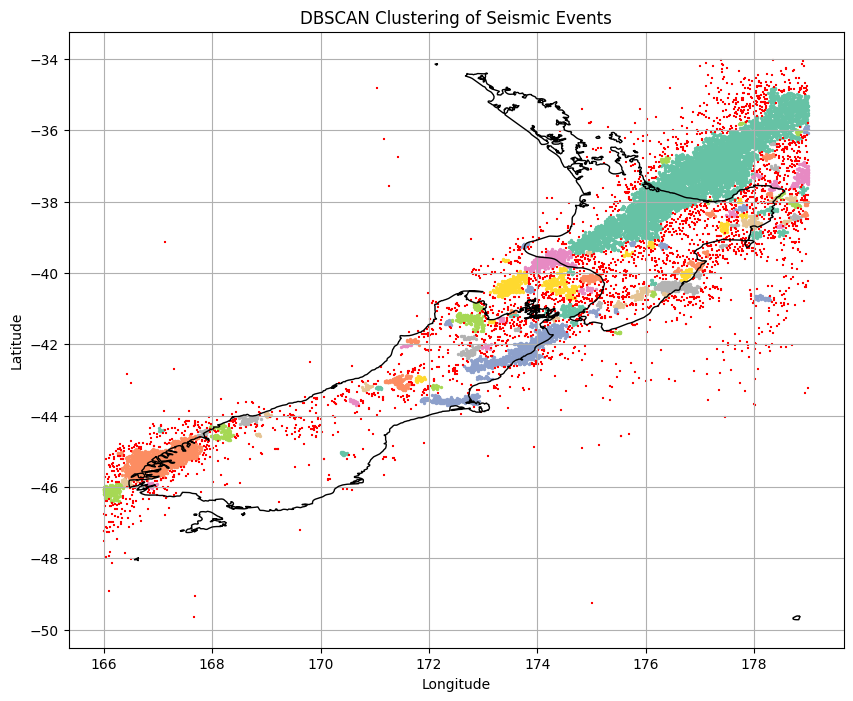

With Magnitude > 3.7, Min Samples = 9 & eps = 0.07:


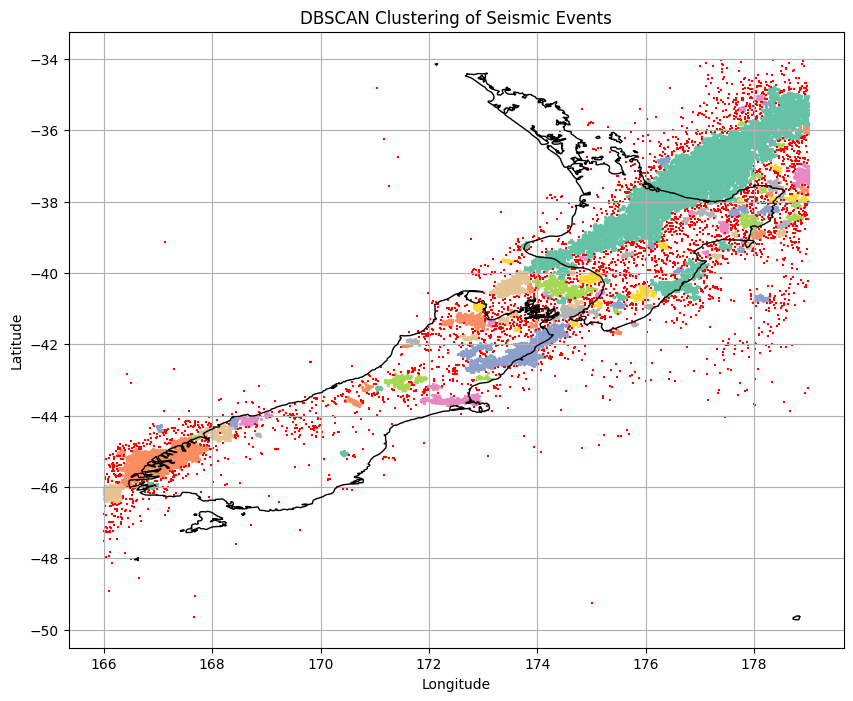

CPU times: user 4.12 s, sys: 99.8 ms, total: 4.22 s
Wall time: 3.29 s


In [40]:
%%time
print("With Magnitude > 3.8, Min Samples = 8 & eps = 0.07:")
NZcl1, _ = cluster_plot(NZdata,[(NZdata['eventtype']=='earthquake'), (NZdata['magnitude']>3.8)],8,0.07)
print("With Magnitude > 3.7, Min Samples = 9 & eps = 0.07:")
NZcl2, _ = cluster_plot(NZdata,[(NZdata['eventtype']=='earthquake'), (NZdata['magnitude']>3.7)],9,0.07)

## splines

In [41]:
import shapely
from scipy.interpolate import splprep, splev
from math import sqrt
from shapely.geometry import LineString
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
from rtree import index

In [42]:
#Function to calculate the distances between a point and a spline:
def calculate_distances(points,spline_points):
    points=np.array(points)
    spline_points = np.array(spline_points)
    distances = np.sqrt((points[:,0][:,np.newaxis]-spline_points[0])**2 + (points[:,1][:,np.newaxis] -spline_points[1])**2)
    return distances

In [43]:
#Function to fit splines and calculate max of the minimum error for a single cluster:
def fit_spline(cluster_data):
    cluster_data=np.array(cluster_data)
    cluster_data=np.unique(cluster_data,axis=0)
    x=cluster_data[:,0]
    y=cluster_data[:,1]
    #Fit spline
    try:
        tck, u = splprep([x,y],s=10*len(x))
        spline_points = splev(u,tck)
    except Exception as e:
        raise RuntimeError(f"Error fitting spline: {e}")
    #Calculate the distances
    distances = calculate_distances(cluster_data, spline_points)
    max_min_distance = np.max(distances)
    # Original parameter range
    u_min, u_max = np.min(u), np.max(u)
    #Extend spline points by 10%
    unew = np.linspace(u_min-0.05,u_max+0.05,500)
    extended_spline = np.array(splev(unew,tck))

    return tck, max_min_distance, extended_spline

In [44]:
def extended_spline_to_lines(extended_spline):
    lines = []
    for i in range(len(extended_spline[0]) - 1):
        line = LineString([(extended_spline[0][i], extended_spline[1][i]),
                           (extended_spline[0][i + 1], extended_spline[1][i + 1])])
        lines.append(line)
    return lines

In [45]:
def merge_clusters(cluster_info):
    merged_clusters = {}
    cluster_lines = {}
    
    # Create LineString objects for each cluster
    for label, info in cluster_info.items():
        extended_spline = info['extended_spline']
        cluster_lines[label] = extended_spline_to_lines(extended_spline)
    
    # Check for intersections between lines
    labels = list(cluster_lines.keys())
    for i, label_i in enumerate(labels):
        lines_i = cluster_lines[label_i]
        for j, label_j in enumerate(labels):
            if i >= j:
                continue
            lines_j = cluster_lines[label_j]
            for line_i in lines_i:
                for line_j in lines_j:
                    if line_i.intersects(line_j):
                        merged_clusters[label_j] = label_i

    return merged_clusters

In [46]:
#Function to classify new points from existing cluster splines:
def classify_new_points(new_points, splines):
    classifications = []
    for point in new_points:
        min_distance = float('inf')
        best_label=-1
        for label, info in splines.items():
            tck=info['tck']
            max_min_distance = info['error']
            ex_spline = info['extended_spline']
            distances = calculate_distances(np.array([point]),ex_spline)
            distance = np.min(distances)
            if distance < max_min_distance:
                if distance < min_distance:
                    min_distance = distance
                    best_label = label
        classifications.append(best_label if min_distance < float('inf') else -1)
    return classifications

In [47]:
#Function pipeline to cluster the data:
def clustering_pipeline(df,conds_list,mcs,eps):
    """
    Parameters:
    - df: Dataframe containing the data with 'latitude' and 'longitude' columns
    - conds_list: List of conditions to subset the dataframe
    - mcs: Minimum number of cluster samples parameter for dbscan
    - eps: epsilon value for dbscan

    Returns:
    - A dataframe with cluster labels and processed data
    - A dictionary containing spline information for each cluster
    """
    #Apply conditions to subset data and find initial clusters:
    clusters, df =clusterer(df,conds_list,mcs,eps)
    df['cluster'] = clusters
    unique_clusters = set(clusters)
    print("clusters assigned")
    print(unique_clusters)
    # Sequentially process each cluster
    cluster_data = {label: df[df['cluster']==label][['latitude','longitude']].values for label in unique_clusters if label != -1}
    splines_info = {}
    for label, data in cluster_data.items():
        try:
            result = fit_spline(data)
            splines_info[label] = {
                'tck': result[0],
                'error': result[1],
                'extended_spline': result[2]
            }
        except Exception as e:
            print(f"Failed to fit spline for cluster {label}: {e} data: {data}")
    print("splines fitted")
    #Merge clusters if extended splines overlap:
    merged_clusters = merge_clusters(splines_info)
    for old_label, new_label in merged_clusters.items():
        df['cluster'].replace(old_label,new_label)
    print("close clusters merged")
    print(set(df['cluster']))
    #Refit splines for merged clusters:
    cluster_data = {label: df[df['cluster']==label][['latitude','longitude']].values for label in set(df['cluster']) if label != -1}
    splines_info = {}
    for label, data in cluster_data.items():
        try:
            result = fit_spline(data)
            splines_info[label] = {
                'tck': result[0],
                'error': result[1],
                'extended_spline': result[2]
            }
        except Exception as e:
            print(f"Failed to fit spline for cluster {label}: {e} data: {data}")
            
    print("splines adjusted")
    #Reclassify noise points:
    noise_points = df[df['cluster']==-1][['latitude','longitude']].values
    new_classifications = classify_new_points(noise_points, splines_info)
    df.loc[df['cluster']==-1,'cluster']=new_classifications
    print("noise points updated")
    #Return the processed dataframe and the fitted model(splines info)
    return df, splines_info

In [48]:
%%time
df = NZdata
conds_list = [(NZdata['eventtype']=='earthquake'), (NZdata['magnitude']>3.8)]
mcs = 8
eps = 0.07
processedNZ, national_model = clustering_pipeline(df,conds_list,mcs,eps)

clusters assigned
{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, -1}
splines fitted


KeyboardInterrupt: 

In [49]:
def plot_splines(splines_info):
    plt.figure(figsize=(12, 8))
    for polygon in nz_geometry['coordinates']:
            for coords in polygon:
                x, y = zip(*coords)
                plt.plot(x, y, color='black', linewidth=0.5)

    # Iterate over each spline in splines_info
    for label, info in splines_info.items():
        extended_spline = info['extended_spline']
        # Plot each spline
        plt.plot( extended_spline[1],extended_spline[0], label=f'Cluster {label}')

    # Adding labels and title
    plt.title('Cluster Splines')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.grid(True)
    plt.show()


plot_splines(national_model)

NameError: name 'national_model' is not defined

In [53]:
def plot_new_clusters(df):
    # Number of clusters excluding noise (label=-1)
    num_clusters = len(set(df['cluster'])) - (1 if -1 in df['cluster'] else 0)
    
    # Generate cluster colors using Seaborn's color palette
    cluster_colors = sns.color_palette('viridis', num_clusters)
    
    # Plotting
    plt.figure(figsize=(10, 8))
    for polygon in nz_geometry['coordinates']:
            for coords in polygon:
                x, y = zip(*coords)
                plt.plot(x, y, color='black', linewidth=1)
    # Iterate over clusters and plot points
    for cluster_label, color in zip(set(df['cluster']), cluster_colors):
        if cluster_label != -1:
            # Plot cluster points with cluster-specific color
            plt.scatter(df['longitude'][df['cluster'] == cluster_label], df['latitude'][df['cluster'] == cluster_label],
                        color=color, s=2, label=f'Cluster {cluster_label}')
    # Plot noise points as red '+'
    plt.scatter(df['longitude'][df['cluster'] == -1], df['latitude'][df['cluster'] == -1],
                color='red', marker='+', s=4, label='Noise')
        
    
    # Plot formatting
    plt.title('HDBSCAN Clustering of Seismic Events')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.grid(True)
    plt.show()

In [54]:
plot_new_clusters(processedNZ)

NameError: name 'processedNZ' is not defined

## Quakes data

In [55]:
quakes = Wdata[Wdata['eventtype']=='earthquake']

In [56]:
quakes.shape

(75245, 9)

In [57]:
quakes.eventtype.unique()

array(['earthquake'], dtype=object)

In [58]:
quakes.describe()

,longitude,latitude,magnitude,depth,originerror,magnitudeuncertainty
count,75245.000000,75245.000000,75245.000000,75245.000000,75245.000000,75245.000000
mean,174.726369,-41.194282,2.242577,29.250343,0.215274,0.139894
std,0.525766,0.394509,0.783093,18.073877,0.228861,0.094971
min,173.581910,-42.169460,-9.000000,0.000000,0.000000,0.000000
25%,174.298190,-41.565390,1.901002,16.504036,0.115520,0.079000
50%,174.666470,-41.161600,2.193000,26.766300,0.178790,0.147000
75%,175.148730,-40.900000,2.545000,33.900000,0.264870,0.199000
max,175.961490,-40.386300,6.493255,227.721000,47.408910,1.335000


In [59]:
quakes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75245 entries, 0 to 98364
Data columns (total 9 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   publicid              75245 non-null  object 
 1   eventtype             75245 non-null  object 
 2   origintime            75245 non-null  object 
 3   longitude             75245 non-null  float64
 4   latitude              75245 non-null  float64
 5   magnitude             75245 non-null  float64
 6   depth                 75245 non-null  float64
 7   originerror           75245 non-null  float64
 8   magnitudeuncertainty  75245 non-null  float64
dtypes: float64(6), object(3)
memory usage: 5.7+ MB


In [60]:
quakes.origintime.dtype

dtype('O')

In [61]:
bad = quakes[quakes['magnitude']<0]

In [62]:
bad.shape

(179, 9)

In [63]:
bad.describe()

,longitude,latitude,magnitude,depth,originerror,magnitudeuncertainty
count,179.000000,179.000000,179.0,179.000000,179.000000,179.0
mean,174.511049,-41.216790,-9.0,39.927288,0.134997,0.0
std,0.618413,0.370787,0.0,26.974111,0.096975,0.0
min,173.591630,-42.003430,-9.0,5.000000,0.017300,0.0
25%,173.963150,-41.491545,-9.0,24.407600,0.069045,0.0
50%,174.474120,-41.180270,-9.0,31.080400,0.110000,0.0
75%,175.079920,-40.980300,-9.0,59.130900,0.162190,0.0
max,175.815370,-40.399440,-9.0,210.892700,0.702620,0.0


In [64]:
quakes['origintime'] = pd.to_datetime(quakes['origintime'],utc=True)
qmean_mag=np.mean(quakes[quakes['magnitude']>0]['magnitude'])
qmean_mag


2.269385831006847

In [65]:
# Replace values in 'magnitude' that are less than 0 with qmean_mag
quakes.loc[quakes['magnitude'] < 0, 'magnitude'] = qmean_mag

In [66]:
quakes.describe()

,longitude,latitude,magnitude,depth,originerror,magnitudeuncertainty
count,75245.000000,75245.000000,75245.000000,75245.000000,75245.000000,75245.000000
mean,174.726369,-41.194282,2.269386,29.250343,0.215274,0.139894
std,0.525766,0.394509,0.558418,18.073877,0.228861,0.094971
min,173.581910,-42.169460,0.239123,0.000000,0.000000,0.000000
25%,174.298190,-41.565390,1.905000,16.504036,0.115520,0.079000
50%,174.666470,-41.161600,2.196000,26.766300,0.178790,0.147000
75%,175.148730,-40.900000,2.545000,33.900000,0.264870,0.199000
max,175.961490,-40.386300,6.493255,227.721000,47.408910,1.335000


In [67]:
quakes['energy']=10**(4.4+1.5*quakes['magnitude'])
quakes=quakes.sort_values(by='origintime')

In [68]:
def cluster_plot2(df, mcs, eps):
    db = DBSCAN(eps=eps, min_samples=mcs, n_jobs=-1)
    clusters = db.fit_predict(df[['longitude', 'latitude']])
    # Number of clusters excluding noise (label=-1)
    num_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
    
    # Generate cluster colors using Seaborn's color palette
    cluster_colors = sns.color_palette('Set2', num_clusters)
    
    # Plotting
    plt.figure(figsize=(10, 8))
    
    # Plot bounding box for context
    for polygon in nz_geometry['coordinates']:
        for coords in polygon:
            x, y = zip(*coords)
            # Filter points within the bounding box
            x_filtered, y_filtered = [], []
            for xi, yi in zip(x, y):
                if 135.5 <= xi <= 176 and -42.25 <= yi <= -40.25:
                    x_filtered.append(xi)
                    y_filtered.append(yi)
            plt.plot(x_filtered, y_filtered, color='black', linewidth=1)
    
    # Iterate over clusters and plot points
    for cluster_label, color in zip(set(clusters), cluster_colors):
        if cluster_label != -1:
            # Plot cluster points with cluster-specific color
            plt.scatter(df['longitude'][clusters == cluster_label], 
                        df['latitude'][clusters == cluster_label],
                        color=color, s=2, label=f'Cluster {cluster_label}')
    
    # Plot noise points as red '+'
    plt.scatter(df['longitude'][clusters == -1], 
                df['latitude'][clusters == -1],
                color='red', marker='+', s=4, label='Noise')
    
    # Set plot limits
    plt.xlim(173.5, 176)
    plt.ylim(-42.25, -40.25)
    
    # Plot formatting
    plt.title('DBSCAN Clustering of Seismic Events within 100km of Wellington centre')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.grid(True)
    plt.show()

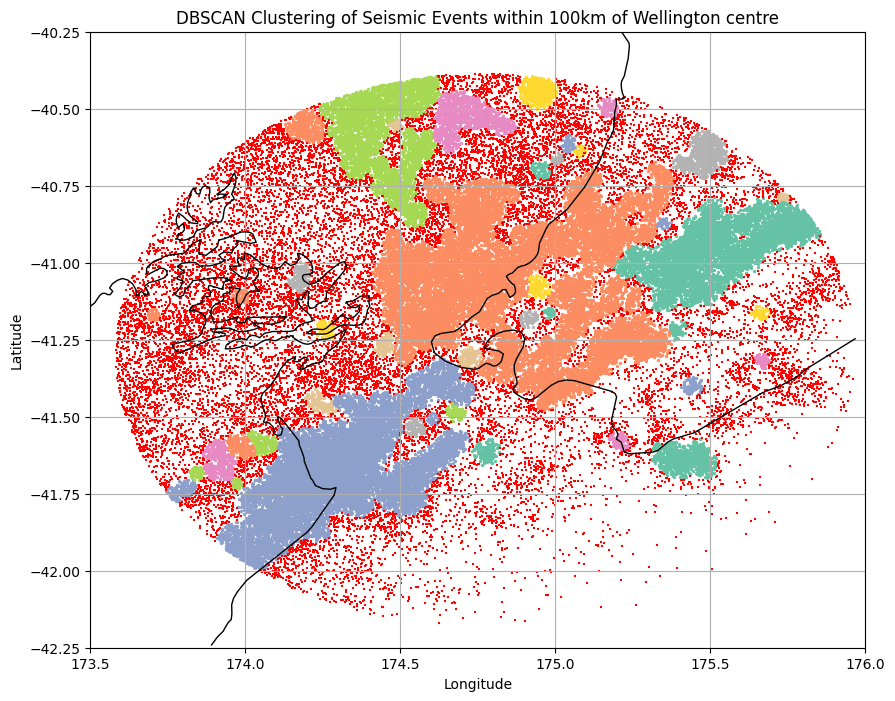

In [69]:
cluster_plot2(quakes, 40, 0.02)

### With Folium

In [70]:
def generateBaseMap(default_location=[-41.28664, 174.77557], default_zoom_start=8):
    '''
    Create a base map
    '''
    base_map = folium.Map(
        location = default_location
        , control_scale = True
        , zoom_start = default_zoom_start
    )

    return base_map

In [71]:
base_map = generateBaseMap()
for index, row in quakes.tail(20000).iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='purple'
    ).add_to(base_map)

# Display the map
display(base_map)

In [72]:
base_map = generateBaseMap(default_zoom_start=7)
for index, row in fiveplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='purple'
    ).add_to(base_map)

# Display the map
display(base_map)

In [73]:
base_map = generateBaseMap(default_zoom_start=6)
for index, row in sixplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='purple'
    ).add_to(base_map)

# Display the map
display(base_map)

In [74]:
base_map = generateBaseMap(default_zoom_start=6)
for index, row in threeminus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='deeppink', radius=1, fill_opacity=0.7
    ).add_to(base_map)
for index, row in threeplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='purple', radius=2, fill_opacity=0.5
    ).add_to(base_map)
for index, row in fourplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='green', radius=3, fill_opacity=0.5
    ).add_to(base_map)
for index, row in fiveplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='blue', radius=6, fill_opacity=0.5
    ).add_to(base_map)
for index, row in sixplus.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],  
        color='black', radius=7, fill_opacity=0.5
    ).add_to(base_map)
# Display the map
display(base_map)

## Time Series

In [75]:
quakes.head()

,publicid,eventtype,origintime,longitude,latitude,magnitude,depth,originerror,magnitudeuncertainty,energy
98364,1685163,earthquake,1982-01-01 04:56:00.600000+00:00,175.27299,-40.958,1.875,32.7,0.13,0.116,1.631173e+07
98363,1685164,earthquake,1982-01-02 18:02:11.540000+00:00,175.18800,-41.134,1.700,26.9,0.02,0.100,8.912509e+06
98362,1685165,earthquake,1982-01-02 22:57:15+00:00,175.24500,-41.156,2.200,29.8,0.17,0.141,5.011872e+07
98361,1685166,earthquake,1982-01-03 15:46:21.310000+00:00,175.17500,-40.698,2.100,38.5,0.22,0.141,3.548134e+07
98360,1685167,earthquake,1982-01-04 01:34:43.600000+00:00,174.27200,-41.773,2.425,15.1,0.54,0.096,1.090184e+08


In [76]:
quakes['year']=quakes['origintime'].dt.year
quakes['month']=quakes['origintime'].dt.month
quakes['is_big']=quakes['magnitude']>=5
quakes['cumsum_e_since_big']=0
cumulative_sum=0
# Iterate over each event
for idx, row in quakes.iterrows():
    if row['is_big']:
        # For a big event, the cumulative sum up to this point is finalized
        quakes.at[idx, 'cumsum_e_since_big'] = cumulative_sum
        # Reset cumulative sum (but do not include the current event's energy)
        cumulative_sum = 0
    else:
        # Update cumulative sum for non-big events
        cumulative_sum += row['energy']
        quakes.at[idx, 'cumsum_e_since_big'] = cumulative_sum


In [77]:
quakes.sort_values('origintime',inplace=True)

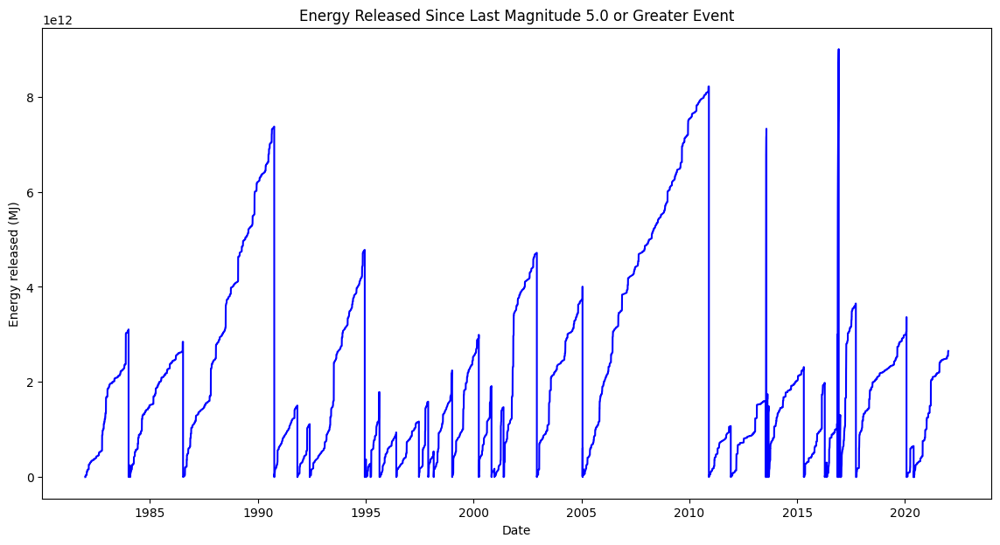

In [78]:
plt.figure(figsize=(14, 7))
# Plot cumulative sum of energy released since the last magnitude 5.0+ event
plt.plot(quakes['origintime'], quakes['cumsum_e_since_big'], marker='none', linestyle='-', color='blue')
# Add title and labels
plt.title('Energy Released Since Last Magnitude 5.0 or Greater Event')
plt.xlabel('Date')
plt.ylabel('Energy released (MJ)')
plt.show()

In [79]:
externals = pd.concat([fiveplus,sixplus])
externals['origintime'] = pd.to_datetime(externals['origintime'],utc=True)
externals = externals.sort_values(by='origintime')
externals = externals.reset_index(drop=True)
externals['year']=externals['origintime'].dt.year
externals['month']=externals['origintime'].dt.month
externals.shape

(334, 11)

In [80]:
bigs = quakes[quakes['magnitude'] >= 5.0]

In [81]:
# Find the first event with magnitude ≥ 5.0
first_big_date = bigs['origintime'].min().normalize()
# Set the start date to the day after the first event
start_date = first_big_date + pd.Timedelta(days=1)

In [82]:
start_date

Timestamp('1984-01-04 00:00:00+0000', tz='UTC')

In [83]:
# Generate date range starting from the day after the first event, at 12:00 PM each day
date_range = pd.date_range(start=start_date, 
                           end=quakes['origintime'].max().normalize(), 
                           freq='D')

time_series = pd.DataFrame(date_range, columns=['date'])
time_series['datetime'] = time_series['date'] + pd.Timedelta(hours=12)
# Merge time series with quake events to find the closest event before or at each 12:00 PM timestamp
time_series = pd.merge_asof(time_series.sort_values('datetime'), 
                            bigs.sort_values('origintime'), 
                            left_on='datetime', 
                            right_on='origintime', 
                            direction='backward')

# Calculate the time difference in hours
time_series['hours_since_last_event'] = (time_series['datetime'] - time_series['origintime']).dt.total_seconds() / 3600

In [84]:
display(time_series.shape)
time_series.head()

(13877, 17)

,date,datetime,publicid,eventtype,origintime,longitude,latitude,magnitude,depth,originerror,magnitudeuncertainty,energy,year,month,is_big,cumsum_e_since_big,hours_since_last_event
0,1984-01-04 00:00:00+00:00,1984-01-04 12:00:00+00:00,1564879,earthquake,1984-01-03 22:55:39.020000+00:00,174.19,-40.53,5.2,104.0,0.5,0.0,1.584893e+12,1984,1,True,3.105674e+12,13.072494
1,1984-01-05 00:00:00+00:00,1984-01-05 12:00:00+00:00,1564879,earthquake,1984-01-03 22:55:39.020000+00:00,174.19,-40.53,5.2,104.0,0.5,0.0,1.584893e+12,1984,1,True,3.105674e+12,37.072494
2,1984-01-06 00:00:00+00:00,1984-01-06 12:00:00+00:00,1564879,earthquake,1984-01-03 22:55:39.020000+00:00,174.19,-40.53,5.2,104.0,0.5,0.0,1.584893e+12,1984,1,True,3.105674e+12,61.072494
3,1984-01-07 00:00:00+00:00,1984-01-07 12:00:00+00:00,1564879,earthquake,1984-01-03 22:55:39.020000+00:00,174.19,-40.53,5.2,104.0,0.5,0.0,1.584893e+12,1984,1,True,3.105674e+12,85.072494
4,1984-01-08 00:00:00+00:00,1984-01-08 12:00:00+00:00,1564879,earthquake,1984-01-03 22:55:39.020000+00:00,174.19,-40.53,5.2,104.0,0.5,0.0,1.584893e+12,1984,1,True,3.105674e+12,109.072494


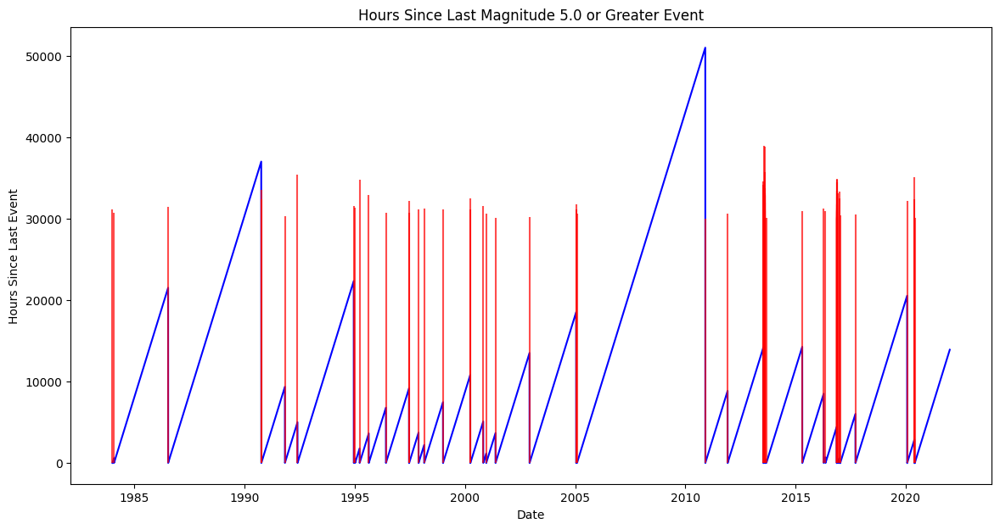

In [85]:
plt.figure(figsize=(14, 7))
# Plot hours since the last magnitude 5.0+ event
plt.plot(time_series['datetime'], time_series['hours_since_last_event'], marker='none', linestyle='-', color='blue')
# Plot external significant events affecting the region
for _, row in bigs.iterrows():
    plt.vlines(x=row['origintime'], ymin=0, ymax=6000 * row['magnitude'], color='red', alpha=0.7)
# Add title and labels
plt.title('Hours Since Last Magnitude 5.0 or Greater Event')
plt.xlabel('Date')
plt.ylabel('Hours Since Last Event')
plt.show()

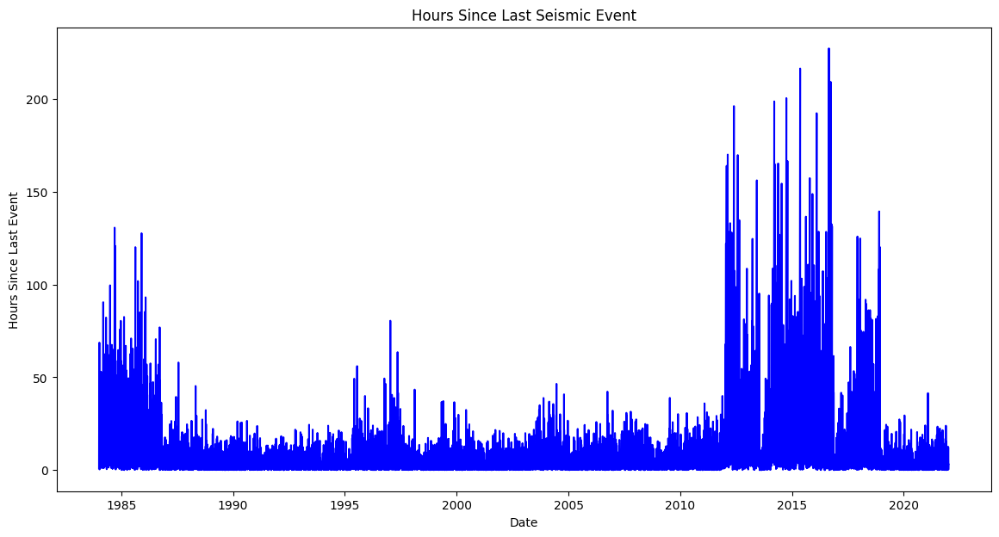

In [86]:
time_series = pd.DataFrame(date_range, columns=['date'])
time_series['datetime'] = time_series['date'] + pd.Timedelta(hours=12)
# Merge time series with quake events to find the closest event before or at each 12:00 PM timestamp
time_series = pd.merge_asof(time_series.sort_values('datetime'), 
                            quakes.sort_values('origintime'), 
                            left_on='datetime', 
                            right_on='origintime', 
                            direction='backward')

# Calculate the time difference in hours
time_series['hours_since_last_event'] = (time_series['datetime'] - time_series['origintime']).dt.total_seconds() / 3600
plt.figure(figsize=(14, 7))
# Plot hours since the last seismic event
plt.plot(time_series['datetime'], time_series['hours_since_last_event'], marker='none', linestyle='-', color='blue')
# Add title and labels
plt.title('Hours Since Last Seismic Event')
plt.xlabel('Date')
plt.ylabel('Hours Since Last Event')
plt.show()

### Monthly Windows

In [87]:
# Group by 'year' and 'month'
grouped = quakes.groupby(['year', 'month'])

In [88]:
# Calculate statistics
def calculate_stats(group):
    avg_magnitude = group['magnitude'].mean()
    total_energy = group['energy'].sum()
    avg_small_energy = group[group['magnitude']<=4]['energy'].mean()
    avg_energy = group['energy'].mean()
    num_events_gt_5 = (group['magnitude'] > 5).sum()
    total_events = len(group)
    
    # Calculate average time between events
    group_sorted = group.sort_values('origintime')
    time_differences = group_sorted['origintime'].diff().dropna()
    avg_time_between_events = time_differences.mean() if not time_differences.empty else pd.NaT
    
    return pd.Series({
        'avg_magnitude': avg_magnitude,
        'total_energy': total_energy,
        'avg_small_energy': avg_small_energy,
        'avg_energy': avg_energy,
        'num_events_gt_5': num_events_gt_5,
        'total_events': total_events,
        'avg_time_between_events': avg_time_between_events
    })

In [89]:
# Apply the function to each group
month_data = grouped.apply(calculate_stats).reset_index()

In [90]:
month_data.head()

,year,month,avg_magnitude,total_energy,avg_small_energy,avg_energy,num_events_gt_5,total_events,avg_time_between_events
0,1982,1,2.202635,1.101481e+11,1.598544e+08,1.059117e+09,0,104,0 days 07:08:18.462135922
1,1982,2,2.253754,5.493680e+10,4.819018e+08,4.819018e+08,0,114,0 days 05:48:13.889115044
2,1982,3,2.260620,1.426855e+11,4.306585e+08,1.321162e+09,0,108,0 days 06:43:15.455233644
3,1982,4,2.042522,4.040587e+10,3.575740e+08,3.575740e+08,0,113,0 days 06:24:19.877678571
4,1982,5,2.095663,3.152091e+10,3.120882e+08,3.120882e+08,0,101,0 days 07:09:48.943200


In [91]:
month_data['datetime'] = pd.to_datetime(month_data[['year', 'month']].assign(day=1))

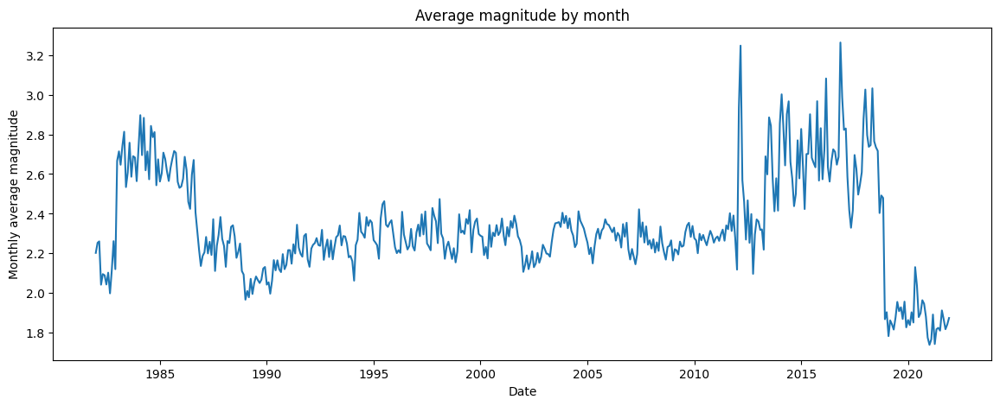

In [92]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['avg_magnitude'], marker='none', linestyle='-')
plt.title('Average magnitude by month')
plt.xlabel('Date')
plt.ylabel('Monthly average magnitude')
plt.show()

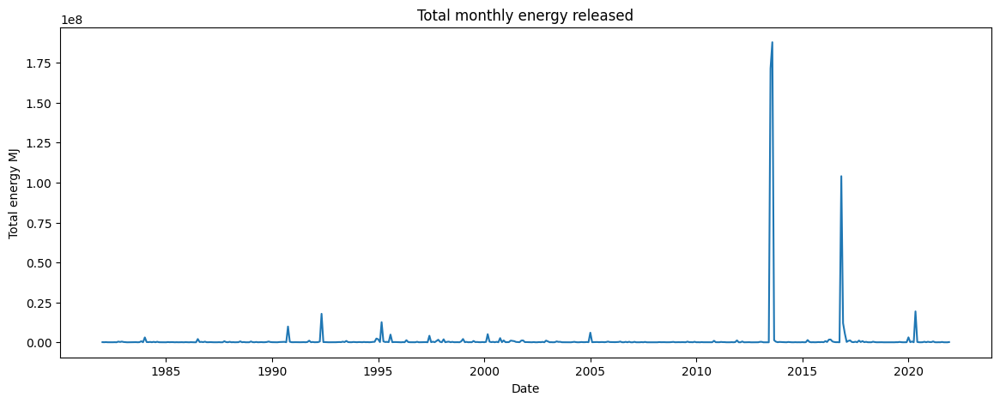

In [93]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['total_energy']/1000000, marker='none', linestyle='-')
plt.title('Total monthly energy released')
plt.xlabel('Date')
plt.ylabel('Total energy MJ')
plt.show()

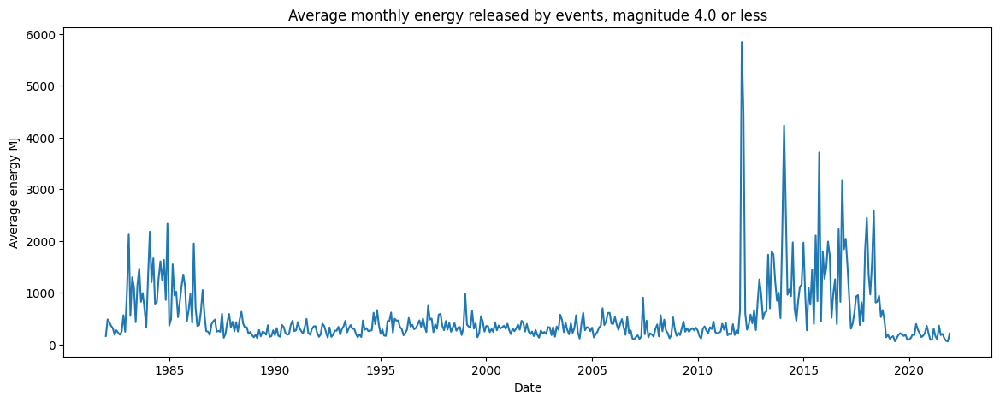

In [94]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['avg_small_energy']/1000000, marker='none', linestyle='-')
plt.title('Average monthly energy released by events, magnitude 4.0 or less')
plt.xlabel('Date')
plt.ylabel('Average energy MJ')
plt.show()

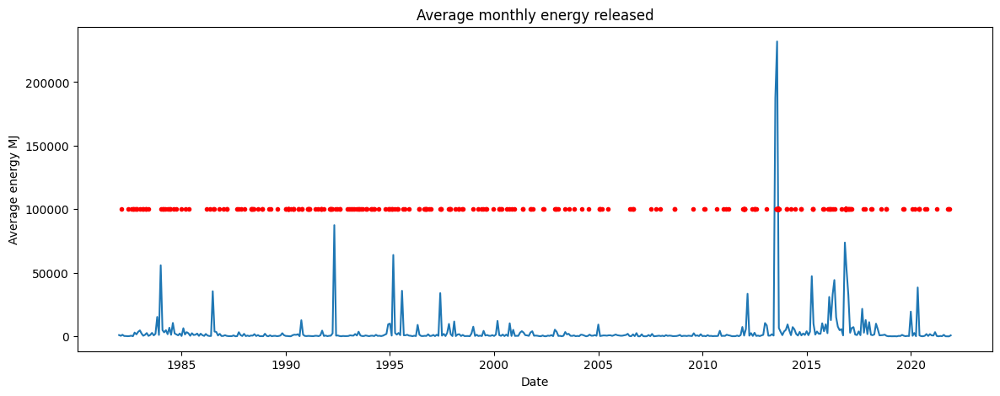

In [95]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['avg_energy']/1000000, marker='none', linestyle='-')
plt.plot(externals['origintime'],[100000]*len(externals['origintime']),marker='.',linestyle='none',color='red')
plt.title('Average monthly energy released')
plt.xlabel('Date')
plt.ylabel('Average energy MJ')
plt.show()

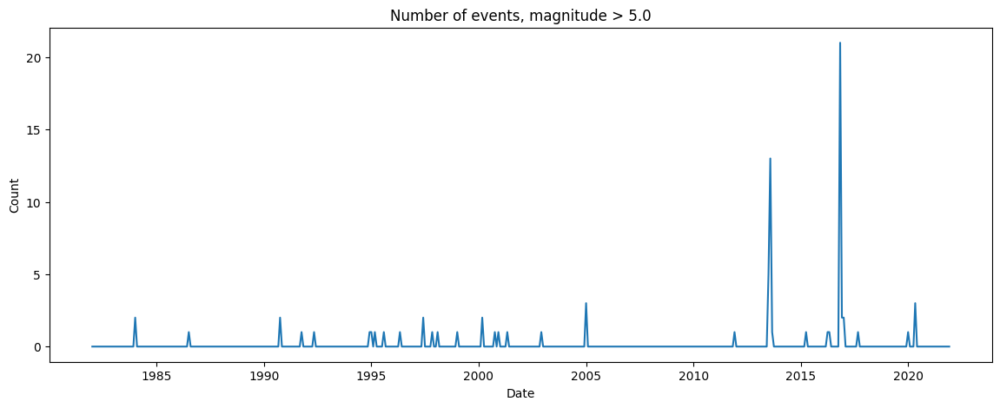

In [96]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['num_events_gt_5'], marker='none', linestyle='-')
plt.title('Number of events, magnitude > 5.0')
plt.xlabel('Date')
plt.ylabel('Count')
plt.show()

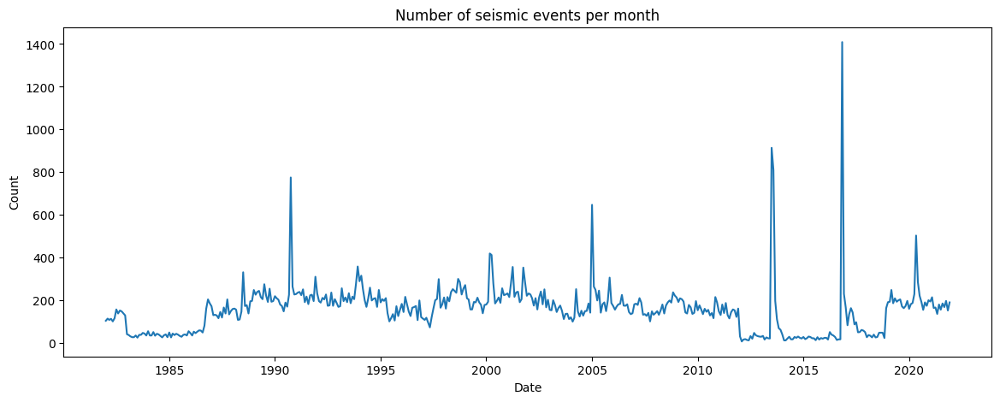

In [97]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['total_events'], marker='none', linestyle='-')
plt.title('Number of seismic events per month')
plt.xlabel('Date')
plt.ylabel('Count')
plt.show()

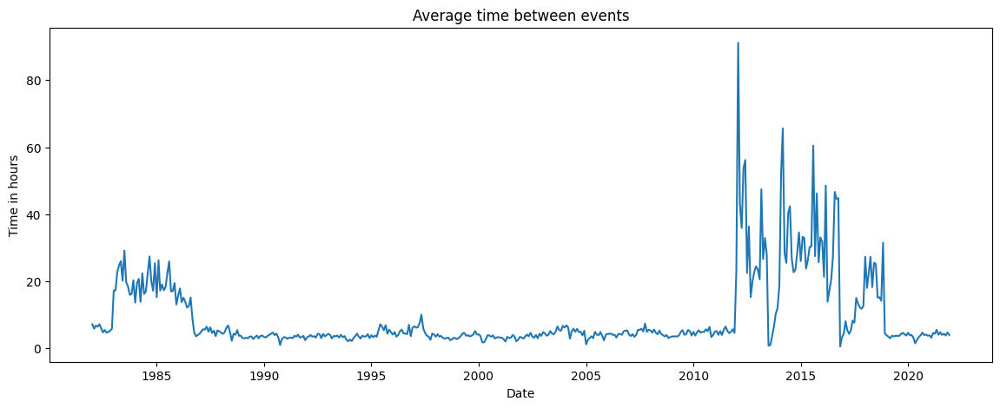

In [98]:
plt.figure(figsize=(14, 5))
plt.plot(month_data['datetime'], month_data['avg_time_between_events'].dt.total_seconds()/3600, marker='none', linestyle='-')
plt.title('Average time between events')
plt.xlabel('Date')
plt.ylabel('Time in hours')
plt.show()

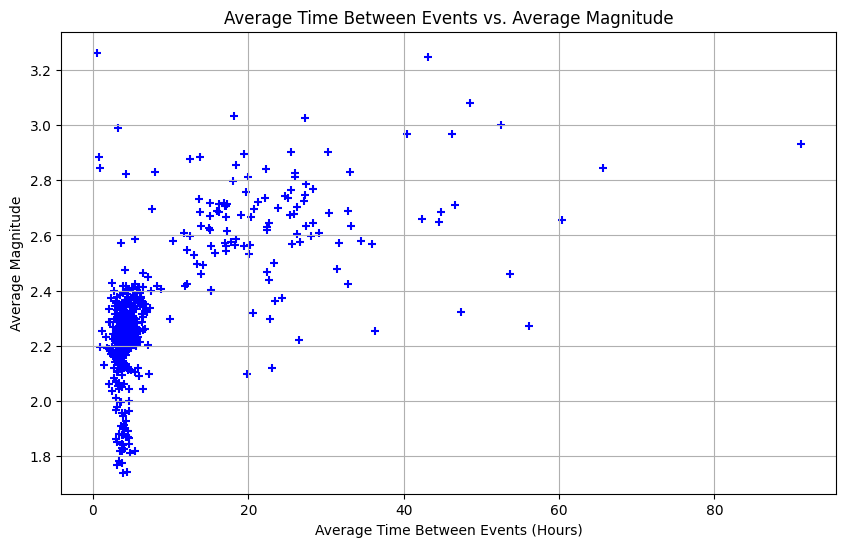

In [99]:
plt.figure(figsize=(10, 6))
plt.scatter(month_data['avg_time_between_events'].dt.total_seconds()/3600, month_data['avg_magnitude'], marker='+', color='blue')

# Plot formatting
plt.title('Average Time Between Events vs. Average Magnitude')
plt.xlabel('Average Time Between Events (Hours)')
plt.ylabel('Average Magnitude')
plt.grid(True)
plt.show()

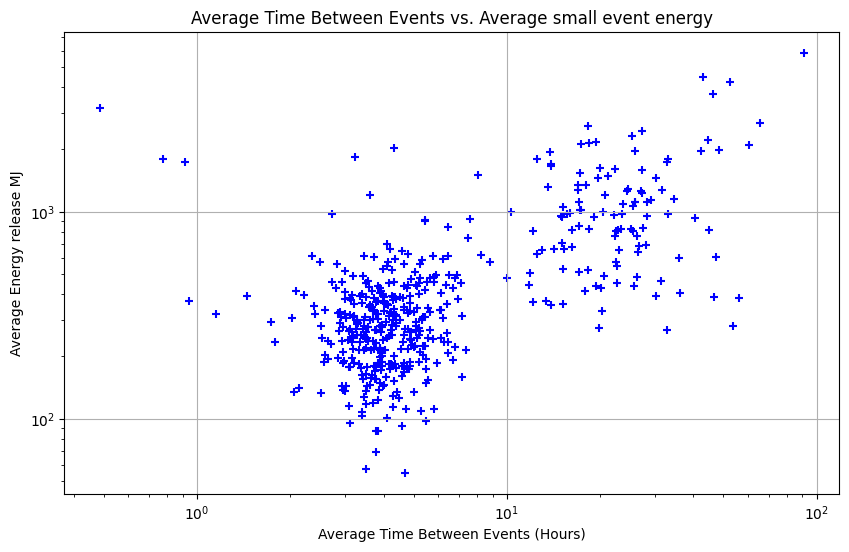

In [100]:
plt.figure(figsize=(10, 6))
plt.scatter(month_data['avg_time_between_events'].dt.total_seconds()/3600, month_data['avg_small_energy']/1000000, marker='+', color='blue')

# Plot formatting
plt.title('Average Time Between Events vs. Average small event energy')
plt.xlabel('Average Time Between Events (Hours)')
plt.ylabel('Average Energy release MJ')
plt.xscale('log')
plt.yscale('log')
plt.grid(True)
plt.show()

In [101]:
from scipy import stats

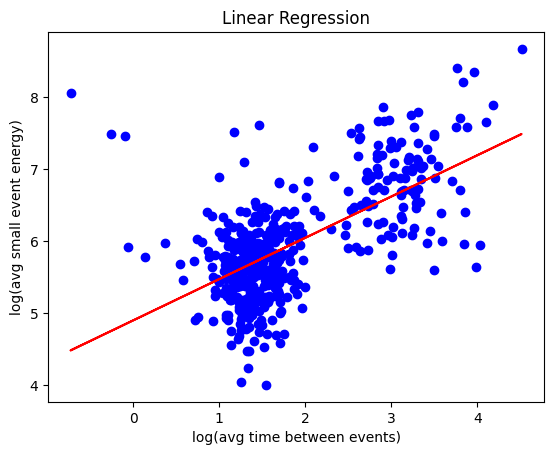

The linear regression has a standard error of 0.0329, a p-value of 0.0, and an r-squared value of 0.6245


In [102]:
X=np.log(month_data['avg_time_between_events'].dt.total_seconds()/3600)
Y=np.log(month_data['avg_small_energy']/1000000)
slope, intercept, r_value, p_value, std_err = stats.linregress(X, Y)
plt.scatter(X, Y, color='blue', label='Data Points')
plt.plot(X, slope*X + intercept, 'r', label='Fitted Line')
plt.xlabel('log(avg time between events)')
plt.ylabel('log(avg small event energy)')
plt.title('Linear Regression')
plt.show()
print(f"The linear regression has a standard error of {round(std_err,4)}, a p-value of {round(p_value,9)}, and an r-squared value of {round(r_value,4)}")

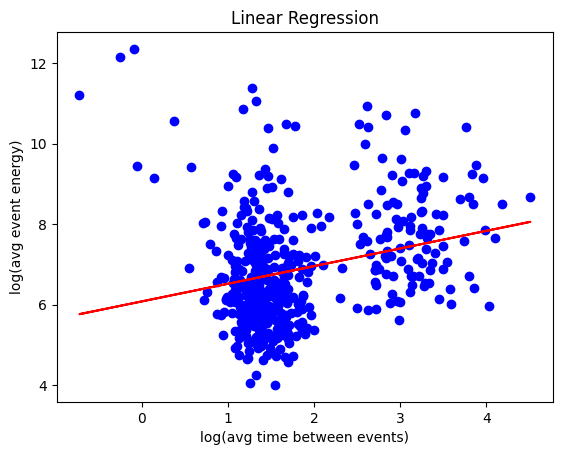

The linear regression has a standard error of 0.0744, a p-value of 7e-09, and an r-squared value of 0.2604


In [103]:
X=np.log(month_data['avg_time_between_events'].dt.total_seconds()/3600)
Y=np.log(month_data['avg_energy']/1000000)
slope1, intercept1, r_value1, p_value1, std_err1 = stats.linregress(X, Y)
plt.scatter(X, Y, color='blue', label='Data Points')
plt.plot(X, slope1*X + intercept1, 'r', label='Fitted Line')
plt.xlabel('log(avg time between events)')
plt.ylabel('log(avg event energy)')
plt.title('Linear Regression')
plt.show()
print(f"The linear regression has a standard error of {round(std_err1,4)}, a p-value of {round(p_value1,9)}, and an r-squared value of {round(r_value1,4)}")

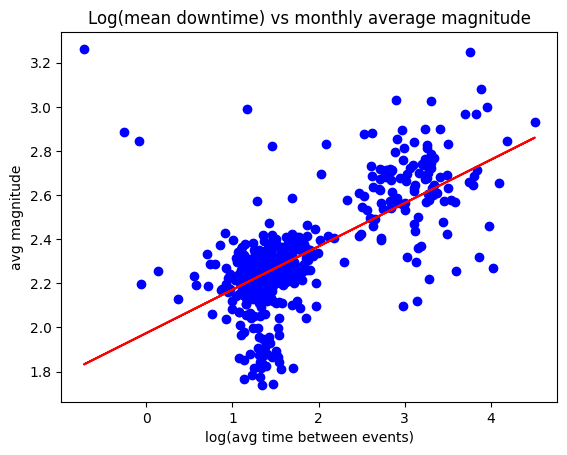

The linear regression has a standard error of 0.0107, a p-value of 0.0, and an r-squared value of 0.6444


In [105]:
X=np.log(month_data['avg_time_between_events'].dt.total_seconds()/3600)
Y=month_data['avg_magnitude']
slope1, intercept1, r_value1, p_value1, std_err1 = stats.linregress(X, Y)
plt.scatter(X, Y, color='blue', label='Data Points')
plt.plot(X, slope1*X + intercept1, 'r', label='Fitted Line')
plt.xlabel('log(avg time between events)')
plt.ylabel('avg magnitude')
plt.title('Log(mean downtime) vs monthly average magnitude')
plt.show()
print(f"The linear regression has a standard error of {round(std_err1,4)}, a p-value of {round(p_value1,9)}, and an r-squared value of {round(r_value1,4)}")

### Yearly Windows

In [106]:
# Group by 'year' and 'month'
grouped2 = quakes.groupby('year')
# Apply the function to each group
year_data = grouped2.apply(calculate_stats).reset_index()

In [107]:
year_data['datetime'] = pd.to_datetime(year_data[['year']].assign(month=1,day=1))

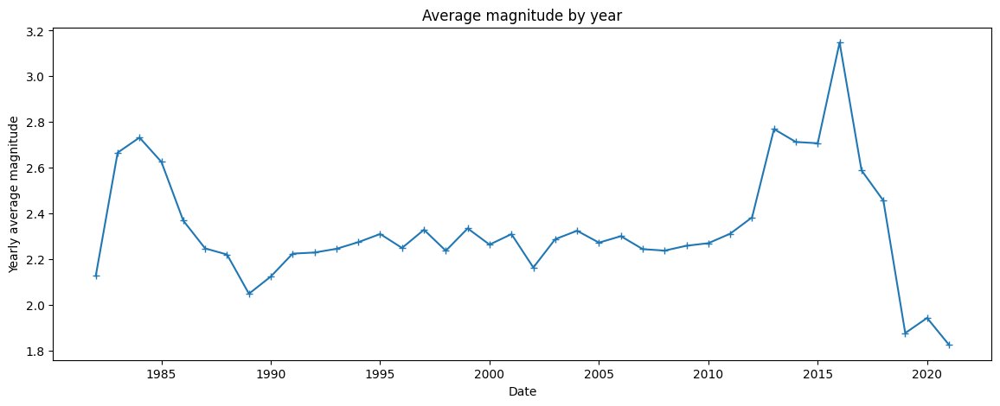

In [108]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['avg_magnitude'], marker='+', linestyle='-')
plt.title('Average magnitude by year')
plt.xlabel('Date')
plt.ylabel('Yearly average magnitude')
plt.show()

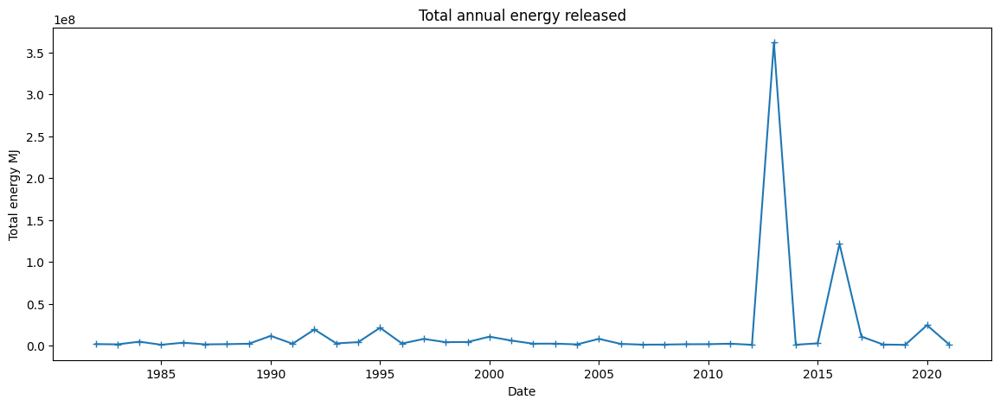

In [109]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['total_energy']/1000000, marker='+', linestyle='-')
plt.title('Total annual energy released')
plt.xlabel('Date')
plt.ylabel('Total energy MJ')
plt.show()

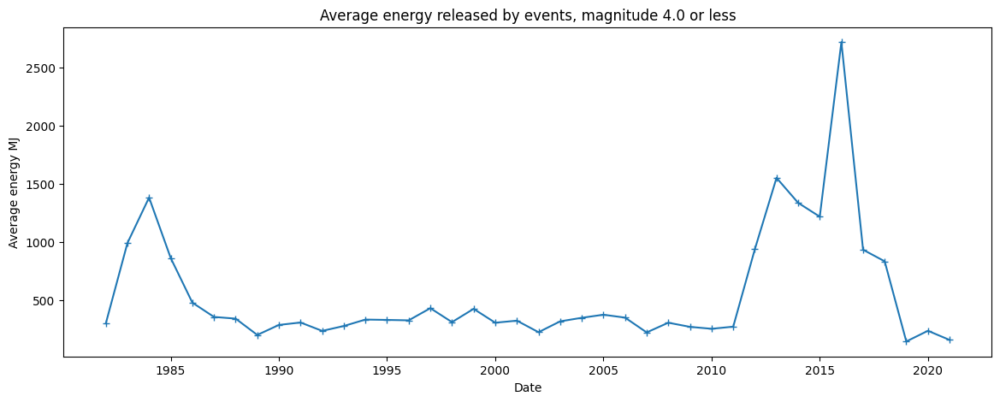

In [110]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['avg_small_energy']/1000000, marker='+', linestyle='-')
plt.title('Average energy released by events, magnitude 4.0 or less')
plt.xlabel('Date')
plt.ylabel('Average energy MJ')
plt.show()

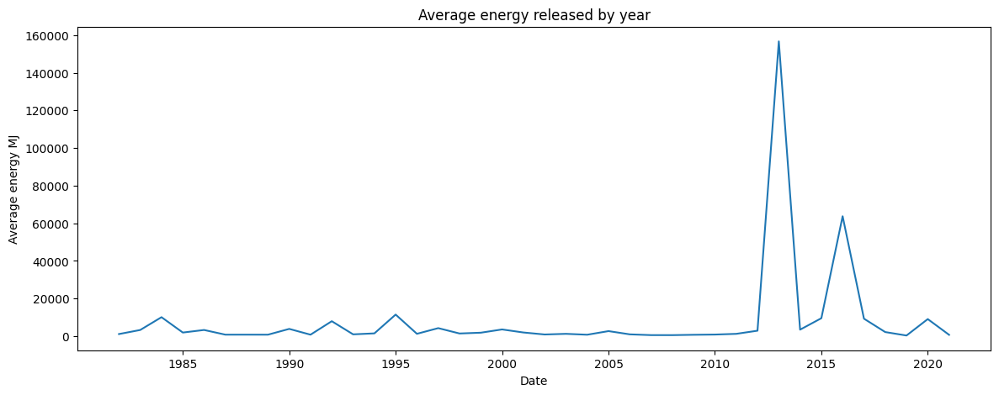

In [111]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['avg_energy']/1000000, marker='none', linestyle='-')
plt.title('Average energy released by year')
plt.xlabel('Date')
plt.ylabel('Average energy MJ')
plt.show()

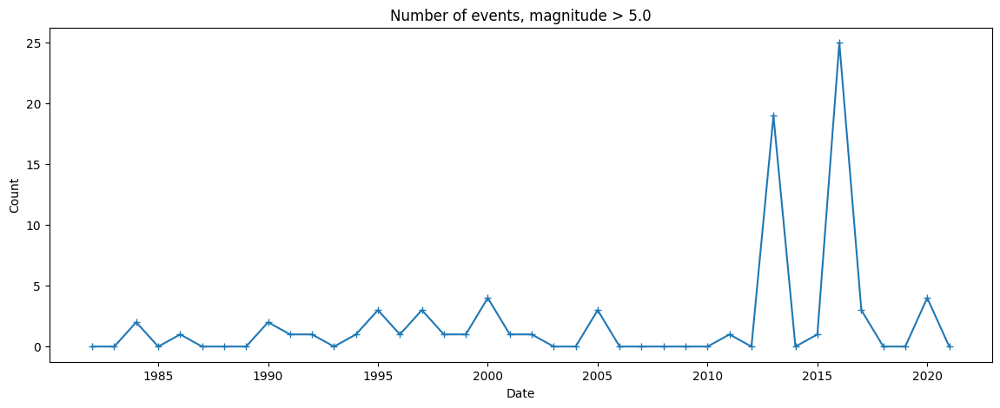

In [112]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['num_events_gt_5'], marker='+', linestyle='-')
plt.title('Number of events, magnitude > 5.0')
plt.xlabel('Date')
plt.ylabel('Count')
plt.show()

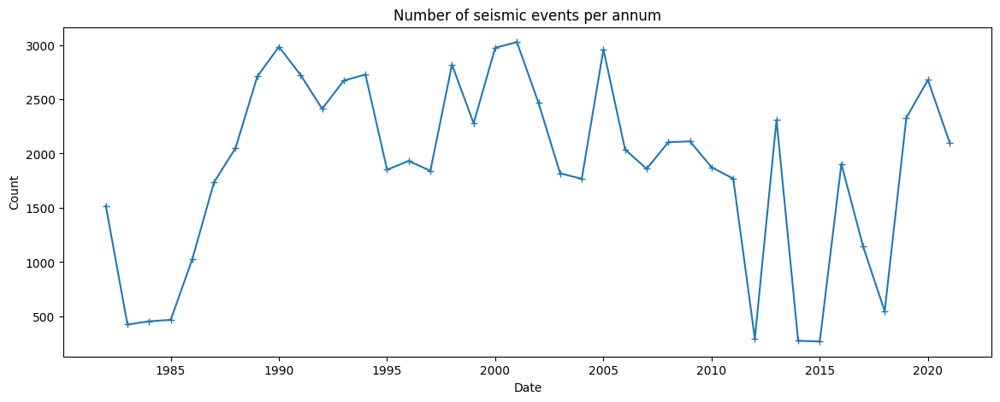

In [113]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['total_events'], marker='+', linestyle='-')
plt.title('Number of seismic events per annum')
plt.xlabel('Date')
plt.ylabel('Count')
plt.show()

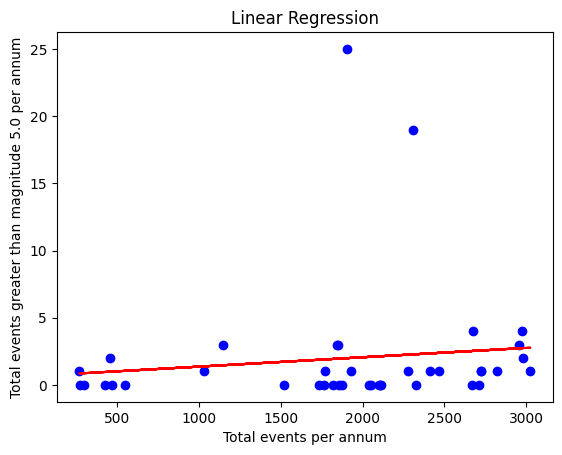

The linear regression has a standard error of 0.0009, a p-value of 0.457966341, and an r-squared value of 0.1208


In [114]:
X=year_data['total_events']
Y=year_data['num_events_gt_5']
slope2, intercept2, r_value2, p_value2, std_err2 = stats.linregress(X, Y)
plt.scatter(X, Y, color='blue', label='Data Points')
plt.plot(X, slope2*X + intercept2, 'r', label='Fitted Line')
plt.xlabel('Total events per annum')
plt.ylabel('Total events greater than magnitude 5.0 per annum')
plt.title('Linear Regression')
plt.show()
print(f"The linear regression has a standard error of {round(std_err2,4)}, a p-value of {round(p_value2,9)}, and an r-squared value of {round(r_value2,4)}")

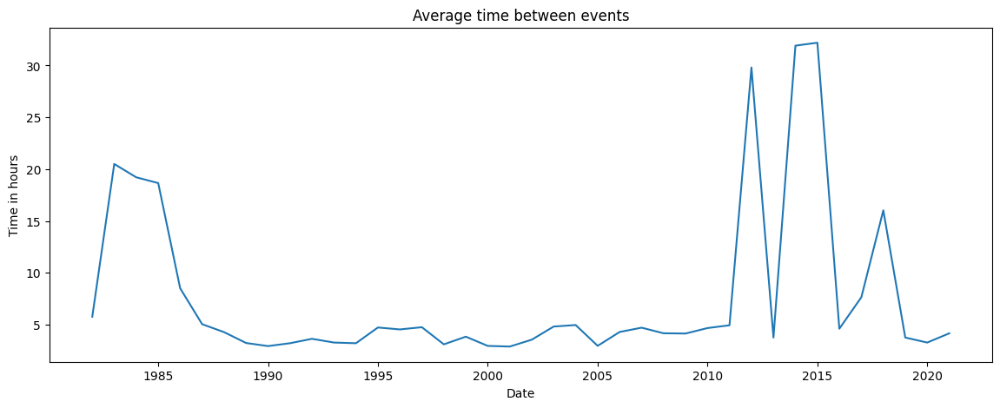

In [115]:
plt.figure(figsize=(14, 5))
plt.plot(year_data['datetime'], year_data['avg_time_between_events'].dt.total_seconds()/3600, marker='none', linestyle='-')
plt.title('Average time between events')
plt.xlabel('Date')
plt.ylabel('Time in hours')
plt.show()

### Rolling aggregations

In [116]:
rolling = Wdata[Wdata['eventtype']=='earthquake']
rolling['origintime'] = pd.to_datetime(rolling['origintime'],utc=True)
rolling.loc[rolling['magnitude'] < 0, 'magnitude'] = qmean_mag
rolling['energy']=10**(4.4+1.5*rolling['magnitude'])
rolling['year']=rolling['origintime'].dt.year
rolling['month']=rolling['origintime'].dt.month
rolling['is_big']=rolling['magnitude']>=5
rolling = rolling.drop(columns=['originerror', 'magnitudeuncertainty', 'eventtype'])
rolling.sort_values('origintime', inplace=True)
rolling.reset_index(drop=True,inplace=True)
rolling['cumsum_e_since_big']=0
cumulative_sum=0
# Iterate over each event
for idx, row in rolling.iterrows():
    if row['is_big']:
        # For a big event, the cumulative sum up to this point is finalized
        rolling.at[idx, 'cumsum_e_since_big'] = cumulative_sum
        # Reset cumulative sum (but do not include the current event's energy)
        cumulative_sum = 0
    else:
        # Update cumulative sum for non-big events
        cumulative_sum += row['energy']
        rolling.at[idx, 'cumsum_e_since_big'] = cumulative_sum
rolling['time_since_last']=rolling['origintime'].diff().dt.total_seconds()/3600
rolling['downtime_since_big'] = rolling['origintime']-rolling['origintime'].where(rolling['is_big']).ffill()
rolling['downtime_since_big']=rolling['downtime_since_big'].dt.total_seconds()/3600
rolling.head()

,publicid,origintime,longitude,latitude,magnitude,depth,energy,year,month,is_big,cumsum_e_since_big,time_since_last,downtime_since_big
0,1685163,1982-01-01 04:56:00.600000+00:00,175.27299,-40.958,1.875,32.7,1.631173e+07,1982,1,False,1.631173e+07,NaN,NaN
1,1685164,1982-01-02 18:02:11.540000+00:00,175.18800,-41.134,1.700,26.9,8.912509e+06,1982,1,False,2.522424e+07,37.103039,NaN
2,1685165,1982-01-02 22:57:15+00:00,175.24500,-41.156,2.200,29.8,5.011872e+07,1982,1,False,7.534296e+07,4.917628,NaN
3,1685166,1982-01-03 15:46:21.310000+00:00,175.17500,-40.698,2.100,38.5,3.548134e+07,1982,1,False,1.108243e+08,16.818419,NaN
4,1685167,1982-01-04 01:34:43.600000+00:00,174.27200,-41.773,2.425,15.1,1.090184e+08,1982,1,False,2.198427e+08,9.806192,NaN


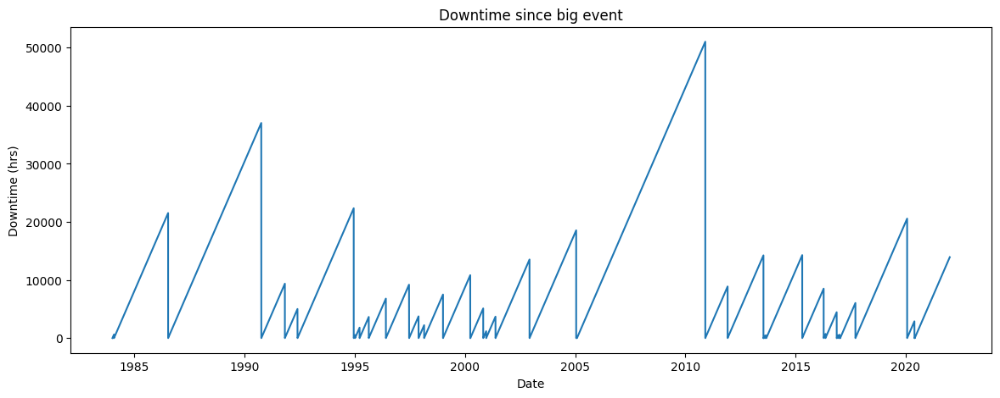

In [117]:
plt.figure(figsize=(14, 5))
plt.plot(rolling['origintime'], rolling['downtime_since_big'], marker='none', linestyle='-')
plt.title('Downtime since big event')
plt.xlabel('Date')
plt.ylabel('Downtime (hrs)')
plt.show()

In [118]:
rolling.set_index('origintime', inplace=True)
# Calculate 20-day rolling average of 'magnitude'
rolling['20_avg_mag'] = rolling['magnitude'].rolling(window='20D').mean()
# Calculate 20-day rolling average of 'downtime'
rolling['20_avg_downtime'] = rolling['time_since_last'].rolling(window='20D').mean()
# Calculate 20-day rolling total of 'energy'
rolling['20_tot_energy'] = rolling['energy'].rolling(window='20D').sum()
# Calculate 20-day rolling average of 'depth'
rolling['20_avg_depth'] = rolling['depth'].rolling(window='20D').mean()
# Calculate rolling count of instances in the last 20 days
rolling['20_day_count'] = rolling['energy'].rolling(window='20D').count()
# Calculate 5-day rolling average of 'magnitude'
rolling['5_avg_mag'] = rolling['magnitude'].rolling(window='5D').mean()
# Calculate 5-day rolling average of 'downtime'
rolling['5_avg_downtime'] = rolling['time_since_last'].rolling(window='5D').mean()
# Calculate 5-day rolling total of 'energy'
rolling['5_tot_energy'] = rolling['energy'].rolling(window='5D').sum()
# Calculate 5-day rolling average of 'depth'
rolling['5_avg_depth'] = rolling['depth'].rolling(window='5D').mean()
# Calculate rolling count of instances in the last 20 days
rolling['5_day_count'] = rolling['energy'].rolling(window='5D').count()
# Reset index 
rolling.reset_index(inplace=True)

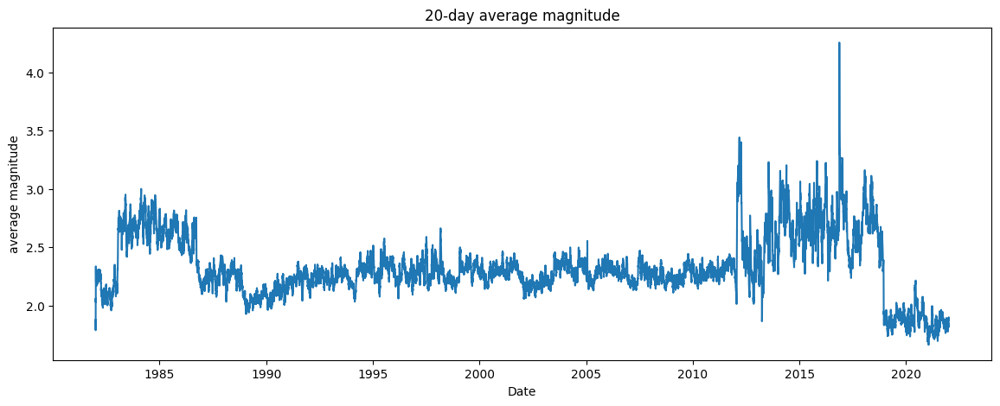

In [119]:
plt.figure(figsize=(14, 5))
plt.plot(rolling['origintime'], rolling['20_avg_mag'], marker='none', linestyle='-')
plt.title('20-day average magnitude')
plt.xlabel('Date')
plt.ylabel('average magnitude')
plt.show()

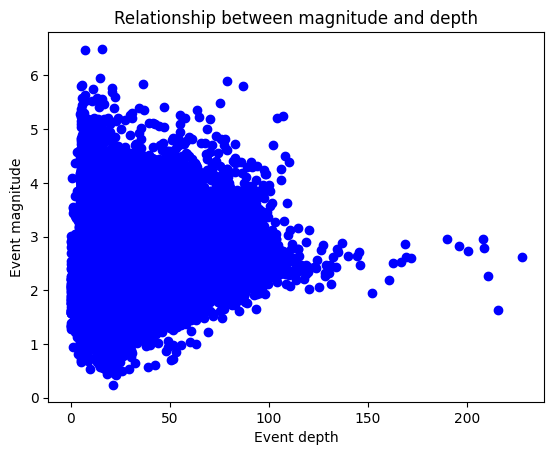

In [120]:
plt.scatter(rolling['depth'], rolling['magnitude'], color='blue', label='Data Points')
plt.xlabel('Event depth')
plt.ylabel('Event magnitude')
plt.title('Relationship between magnitude and depth')
plt.show()

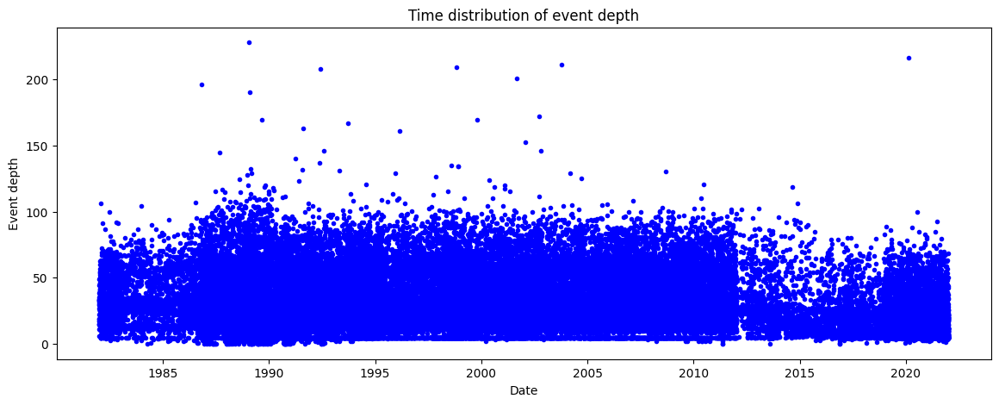

In [121]:
plt.figure(figsize=(14, 5))
plt.plot(rolling['origintime'],rolling['depth'], marker='.', linestyle='none',color='blue', label='Data Points')
plt.xlabel('Date')
plt.ylabel('Event depth')
plt.title('Time distribution of event depth')
plt.show()

In [122]:
rolling.head()

,origintime,publicid,longitude,latitude,magnitude,depth,energy,year,month,is_big,...,20_avg_mag,20_avg_downtime,20_tot_energy,20_avg_depth,20_day_count,5_avg_mag,5_avg_downtime,5_tot_energy,5_avg_depth,5_day_count
0,1982-01-01 04:56:00.600000+00:00,1685163,175.27299,-40.958,1.875,32.7,1.631173e+07,1982,1,False,...,1.87500,NaN,1.631173e+07,32.700,1.0,1.87500,NaN,1.631173e+07,32.700,1.0
1,1982-01-02 18:02:11.540000+00:00,1685164,175.18800,-41.134,1.700,26.9,8.912509e+06,1982,1,False,...,1.78750,37.103039,2.522424e+07,29.800,2.0,1.78750,37.103039,2.522424e+07,29.800,2.0
2,1982-01-02 22:57:15+00:00,1685165,175.24500,-41.156,2.200,29.8,5.011872e+07,1982,1,False,...,1.92500,21.010333,7.534296e+07,29.800,3.0,1.92500,21.010333,7.534296e+07,29.800,3.0
3,1982-01-03 15:46:21.310000+00:00,1685166,175.17500,-40.698,2.100,38.5,3.548134e+07,1982,1,False,...,1.96875,19.613029,1.108243e+08,31.975,4.0,1.96875,19.613029,1.108243e+08,31.975,4.0
4,1982-01-04 01:34:43.600000+00:00,1685167,174.27200,-41.773,2.425,15.1,1.090184e+08,1982,1,False,...,2.06000,17.161319,2.198427e+08,28.600,5.0,2.06000,17.161319,2.198427e+08,28.600,5.0


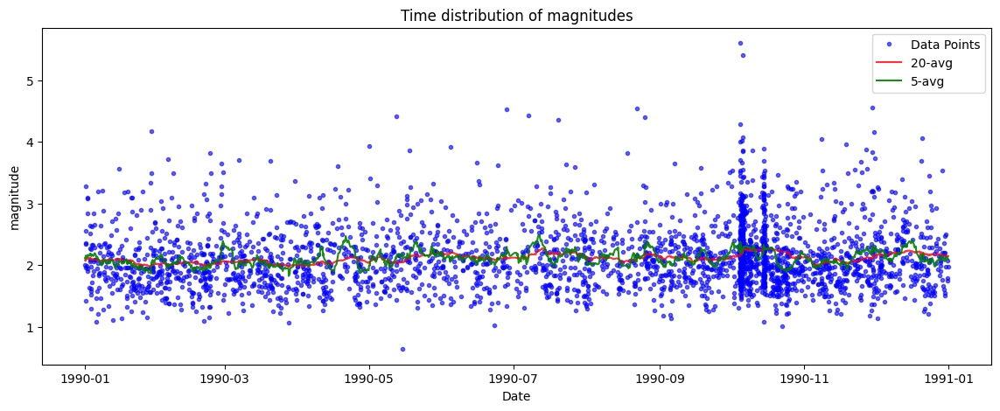

In [123]:
ninety= rolling[rolling['year']==1990]
plt.figure(figsize=(14, 5))
plt.plot(ninety['origintime'],ninety['magnitude'], marker='.', linestyle='none',color='blue', alpha=0.6,label='Data Points')
plt.plot(ninety['origintime'],ninety['20_avg_mag'], marker='none', linestyle='-',color='red', alpha=0.8, label='20-avg')
plt.plot(ninety['origintime'],ninety['5_avg_mag'], marker='none', linestyle='-',color='green', alpha=0.9, label='5-avg')
plt.xlabel('Date')
plt.ylabel('magnitude')
plt.title('Time distribution of magnitudes')
plt.legend()
plt.show()

In [ ]:
MAPE(y1_test,y1_pred1)

In [ ]:
y1_pred2 = emodel2.predict(X1_test_scaled)
print("Random Forest Regressor Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_pred2)}")
print(f"R-squared on training: {round(emodel2.score(X1_train_scaled,y1_train),6)},and testing:{round(emodel2.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_pred2)

In [ ]:
y1_pred3 = emodel3.predict(X1_test_scaled)
print("Support Vector Regressor with C=1 Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_pred3)}")
print(f"R-squared on training: {round(emodel3.score(X1_train_scaled,y1_train),6)},and testing:{round(emodel3.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_pred3)

In [ ]:
y1_pred4 = emodel4.predict(X1_test_scaled)
print("Support Vector Regressor with C=10 Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_pred4)}")
print(f"R-squared on training: {round(emodel4.score(X1_train_scaled,y1_train),6)},and testing:{round(emodel4.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_pred4)

In [ ]:
y1_pred5 = emodel5.predict(X1_test_scaled)
print("Light Gradient Boosting Machine Regression Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_pred5)}")
print(f"R-squared on training: {round(emodel5.score(X1_train_scaled,y1_train),6)},and testing:{round(emodel5.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_pred5)

In [ ]:
y1_pred6 = emodel6.predict(X1_test_scaled)
print("Elastic Net Regression Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_pred6)}")
print(f"R-squared on training: {round(emodel6.score(X1_train_scaled,y1_train),6)},and testing:{round(emodel6.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_pred6)

In [ ]:
y1_predRF = emodelRF.predict(X1_test_scaled)
print("Optimised Random Forest Regressor Model:")
print(f"Mean absolute error on testing: {MAE(y1_test,y1_predRF)}")
print(f"R-squared on training: {round(emodelRF.score(X1_train_scaled,y1_train),6)},and testing:{round(emodelRF.score(X1_test_scaled,y1_test),6)}")

In [ ]:
MAPE(y1_test,y1_predRF)

#### Variable creation

In [ ]:
# Create Target dataframe 'Y2' for prediction if next event i magnitude 5.0 or greater:
Y2=rolling['is_big'].iloc[(st+1):(en+1)]

In [ ]:
sum(Y2)

In [ ]:
len(Y2)

In [ ]:
X2 = X

In [ ]:
true_indices=np.where(Y2)[0]
false_indices=np.where(~Y2)[0]
duplicated_indices=list(true_indices)*200
np.random.seed(94)
sampled_indices=np.random.choice(false_indices, size=15800,replace=False)
combined_indices=np.concatenate([sampled_indices,duplicated_indices])
np.random.shuffle(combined_indices)

In [ ]:
Y3 = Y2.iloc[combined_indices]
X3 = X2.iloc[combined_indices]

In [ ]:
# Split data into training and testing sets
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, Y2, test_size=0.2, random_state=94)
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, Y3, test_size=0.2, random_state=94)

In [ ]:
# Scale features
scaler2 = StandardScaler()
X2_train_scaled = scaler2.fit_transform(X2_train)
X2_test_scaled = scaler2.transform(X2_test)

In [ ]:
scaler3 = StandardScaler()
X3_train_scaled = scaler3.fit_transform(X3_train)
X3_test_scaled = scaler3.transform(X3_test)

#### Modelling

In [ ]:
from sklearn.linear_model import LogisticRegression as LogReg
from sklearn.tree import DecisionTreeClassifier as DTC
from lightgbm import LGBMClassifier as LGBC
from sklearn.ensemble import RandomForestClassifier as RFC
from sklearn.ensemble import StackingClassifier as SC

In [ ]:
%%time
LR = LogReg(max_iter=10000, random_state=94)
LR_params = {
    'C': [0.1,1,10,100],
    'solver': ['lbfgs','sag']
}
# Create a GridSearchCV object
grid_searchLR = GridSearchCV(LR, LR_params, cv=5, scoring='recall',n_jobs=-1)
# Fit the grid search to the data
grid_searchLR.fit(X2_train_scaled, y2_train)
# Get the best parameters
best_paramsLR = grid_searchLR.best_params_
best_modelLR = grid_searchLR.best_estimator_
best_modelLR = best_modelLR.fit(X2_train_scaled, y2_train)
print(f"Best Parameters: {best_paramsLR}")
print(f"Best Recall: {grid_searchLR.best_score_}")
print(f"Train set accuracy of best model is {best_modelLR.score(X2_train_scaled,y2_train)}")
print(f"Test set accuracy of best model is {best_modelLR.score(X2_test_scaled,y2_test)}")

In [ ]:
%%time
DT = DTC(random_state=94)
#Perform gridsearch to optimise parameters
DT_params = {
    'max_depth': [3,5,7],
    'min_samples_split': [2,4,10,20],
    'min_samples_leaf': [1,2,4,6,10],
    'criterion': ["gini","entropy"],
    'min_impurity_decrease': [0.02,0.01,0.001]
}
# Create a GridSearchCV object
grid_searchDT = GridSearchCV(DT, DT_params, cv=5, scoring='recall',n_jobs=-1)
# Fit the grid search to the data
grid_searchDT.fit(X2_train_scaled, y2_train)
# Get the best parameters
best_paramsDT = grid_searchDT.best_params_
best_modelDT = grid_searchDT.best_estimator_
best_modelDT = best_modelDT.fit(X2_train_scaled, y2_train)
print(f"Best Parameters: {best_paramsDT}")
print(f"Best Recall: {grid_searchDT.best_score_}")
print(f"Train set accuracy of best model is {best_modelDT.score(X2_train_scaled,y2_train)}")
print(f"Test set accuracy of best model is {best_modelDT.score(X2_test_scaled,y2_test)}")

In [ ]:
%%time
LGB = LGBC(random_state=94, verbose=-1)
# Perform gridsearch to optimise parameters
LGBC_params = {
    'learning_rate': [0.02,0.04],
    'num_leaves': [11,15,31],
    'max_depth': [7,9],
    'min_child_samples': [5,15,25],
    'n_estimators': [50,100],
    'feature_fraction': [0.6,0.8,1.0] 
    
}
# Create a GridSearchCV object
grid_searchLGB = GridSearchCV(LGB, LGBC_params, cv=5, scoring='recall',n_jobs=-1)
# Fit the grid search to the data
grid_searchLGB.fit(X2_train_scaled, y2_train)
# Get the best parameters
best_paramsLGB = grid_searchLGB.best_params_
best_modelLGB = grid_searchLGB.best_estimator_
best_modelLGB = best_modelLGB.fit(X2_train_scaled, y2_train)
print(f"Best Parameters: {best_paramsLGB}")
print(f"Best Recall: {grid_searchLGB.best_score_}")
print(f"Train set accuracy of best model is {best_modelLGB.score(X2_train_scaled,y2_train)}")
print(f"Test set accuracy of best model is {best_modelLGB.score(X2_test_scaled,y2_test)}")

In [ ]:
%%time
RFc = RFC(random_state=94,n_jobs=-1)
#Perform gridsearch to optimise parameters
RFC_params = {
    'criterion': ["entropy"],
    'max_depth': [None],
    'n_estimators': [50,100,200],
    'max_features': ['auto', 'sqrt'],
    'min_samples_split': [10],
    'bootstrap': [True]
}
# Create a GridSearchCV object
grid_searchRFC = GridSearchCV(RFc, RFC_params, cv=5, scoring='recall',n_jobs=-1)
# Fit the grid search to the data
grid_searchRFC.fit(X2_train_scaled, y2_train)
# Get the best parameters
best_paramsRFC = grid_searchRFC.best_params_
best_modelRFC = grid_searchRFC.best_estimator_
best_modelRFC = best_modelRFC.fit(X2_train_scaled, y2_train)
print(f"Best Parameters: {best_paramsRFC}")
print(f"Best Recall: {grid_searchRFC.best_score_}")
print(f"Train set accuracy of best model is {best_modelRFC.score(X2_train_scaled,y2_train)}")
print(f"Test set accuracy of best model is {best_modelRFC.score(X2_test_scaled,y2_test)}")

In [ ]:
lr = LogReg(solver='lbfgs', max_iter=10000, random_state=94)
estimators = [('mod1', best_modelLR), ('mod2', best_modelDT), ('mod3', best_modelRFC),('mod4', best_modelLGB),('mod5', best_modelRFC)]
sclf = SC(estimators=estimators, final_estimator=lr, cv=5, n_jobs=-1)
Stack_params = {
    'final_estimator__C': [0.1,1, 10, 100]
}
# Create a GridSearchCV object
grid_searchStack = GridSearchCV(sclf, Stack_params, cv=5, scoring='recall',n_jobs=-1,verbose=0)
# Fit the grid search to the data
grid_searchStack.fit(X2_train_scaled, y2_train)
# Get the best parameters
best_paramsStack = grid_searchStack.best_params_
best_modelStack = grid_searchStack.best_estimator_
best_modelStack = best_modelStack.fit(X2_train_scaled, y2_train)
print(f"Best Parameters: {best_paramsStack}")
print(f"Best Recall: {grid_searchStack.best_score_}")
print(f"Train set accuracy of best model is {best_modelStack.score(X2_train_scaled, y2_train)}")
print(f"Test set accuracy of best model is {best_modelStack.score(X2_test_scaled, y2_test)}")

In [ ]:
%%time
LGB2 = LGBC(random_state=94, verbose=-1)
# Perform gridsearch to optimise parameters
LGBC2_params = {
    'learning_rate': [0.02,0.04,0.06],
    'num_leaves': [15,31,45],
    'max_depth': [9,11],
    'min_child_samples': [5,15,25],
    'n_estimators': [50,100],
    'feature_fraction': [0.4,0.6,0.8,1.0] 
    
}
# Create a GridSearchCV object
grid_searchLGB2 = GridSearchCV(LGB2, LGBC2_params, cv=5, scoring='recall',n_jobs=-1)
# Fit the grid search to the data
grid_searchLGB2.fit(X3_train_scaled, y3_train)
# Get the best parameters
best_paramsLGB2 = grid_searchLGB2.best_params_
best_modelLGB2 = grid_searchLGB2.best_estimator_
best_modelLGB2 = best_modelLGB2.fit(X3_train_scaled, y3_train)
print(f"Best Parameters: {best_paramsLGB2}")
print(f"Best Recall: {grid_searchLGB2.best_score_}")
print(f"Train set accuracy of best model is {best_modelLGB2.score(X3_train_scaled,y3_train)}")
print(f"Test set accuracy of best model is {best_modelLGB2.score(X3_test_scaled,y3_test)}")

In [ ]:
balanced_pred = best_modelLGB2.predict(scaler3.transform(X2))

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
pd.DataFrame(confusion_matrix(Y2,balanced_pred), index=['True Negative', 'True Positive'], columns=['Predicted Negative', 'Predicted Positive'])

In [ ]:
%%time
LGB3 = LGBC(random_state=94, verbose=-1)
# Perform gridsearch to optimise parameters
LGBC3_params = {
    'learning_rate': [0.02,0.04,0.06],
    'num_leaves': [15,31,45],
    'max_depth': [9,11],
    'min_child_samples': [5,15,25],
    'n_estimators': [50,100],
    'feature_fraction': [0.4,0.6,0.8,1.0] 
    
}
# Create a GridSearchCV object
grid_searchLGB3 = GridSearchCV(LGB3, LGBC3_params, cv=5, scoring='accuracy',n_jobs=-1)
# Fit the grid search to the data
grid_searchLGB3.fit(X3_train_scaled, y3_train)
# Get the best parameters
best_paramsLGB3 = grid_searchLGB3.best_params_
best_modelLGB3 = grid_searchLGB3.best_estimator_
best_modelLGB3 = best_modelLGB3.fit(X3_train_scaled, y3_train)
print(f"Best Parameters: {best_paramsLGB3}")
print(f"Best Recall: {grid_searchLGB3.best_score_}")
print(f"Train set accuracy of best model is {best_modelLGB3.score(X3_train_scaled,y3_train)}")
print(f"Test set accuracy of best model is {best_modelLGB3.score(X3_test_scaled,y3_test)}")

In [ ]:
balanced_pred2 = best_modelLGB.predict(scaler3.transform(X2))
pd.DataFrame(confusion_matrix(Y2,balanced_pred2), index=['True Negative', 'True Positive'], columns=['Predicted Negative', 'Predicted Positive'])